<table><tr><td><img src="OurGroup1002.jpg" width="360" height="480" /></td><td><img src="INSAIDTELECOM.jpg" width="360" height="480" /></td></tr></table>

## Table of Contents

* [Project Description](#section1)<br>
* [Data Description](#section2)
* [Data Wrangling](#section3)
    - [Understanding the Dataset](#section31)<br/>
        - [Events Data](#section311)<br/>        
        - [Gender Age Data](#section312)<br/>
        - [Device Model Data](#section313)<br/>
    - [Preprocessing](#section32)<br/>
        - [Treatment of Null Values](#section321)<br/>
        - [Outlier Detection and Removal](#section322)<br/>
        - [Chinese Character Treatment](#section323)<br/>   
        - [Feature Engineering on the Event Timestamp](#section324)<br/>   
* [Data Visualisation and Questions answered](#section4)<br/>
    - * [Q.1 What is the spread of users(device_id) across States?](#section41)<br/>
    - * [Q.2 What is the spread of users across Phone Brands(Consider only 10 Most used Phone Brands)?](#section42)<br/>
    - * [Q.3 What is the spread of Users across Gender?](#section43)<br/>
    - * [Q.4 What is the spread of users across Age Segments?](#section44)<br/>
    - * [Q.5 What is the Distribution of Phone Brands(Consider only 10 Most used Phone Brands) for each Age Segment, State, Gender?](#section45)<br/>
    - * [Q.6 What is the Distribution of Gender for each State, Age Segment and Phone Brand(Consider only 10 Most used Phone Brands)?](#section46)<br/>
    - * [Q.7 Distribution of Age Segments for each State, Gender and Phone Brand(Consider only 10 Most used Phone Brands)?](#section47)<br/>
    - * [Q.8 Distribution of Age for each State, Gender and Phone Brand(Consider only 10 Most used Phone Brands)?](#section48)<br/>
    - * [Q.9 Hourly distribution of Phone Calls?](#section49)<br/> 
    - * [Q.10 Day Wise distribution of Phone Calls?](#section50)<br/> 
    - * [Q.11 Month Wise distribution of Phone Calls?](#section51)<br/> 
* [Vsualization using Folium for spread of users](#section5)<br/>
* [Conclusions](#section6)<br/>  

### <a id=section1></a> Project Description

__InsaidTelecom__, one of the leading telecom players, understands that customizing offering is very important for its business to stay competitive. Currently, InsaidTelecom is seeking to leverage behavioral data from more than 60% of the 50 million mobile devices active daily in India to help its clients better understand and interact with their audiences

__Insaidians__ are expected to build a dashboard to understand
user's demographic characteristics based on their mobile usage, geolocation, and mobile device properties.
Doing so will help millions of developers and brand advertisers around the world pursue
data-driven marketing efforts which are relevant to their users and catered to their preferences.

### ****************As We belong to group 1002 we have to analyse data for Maharashtra State only****************

### <a id=section2></a> Data Description

__InsaidTelecom__ stores consumer data in following tables:

1> **events_data** - when a user uses mobile on INSAID Telecom network, the event gets logged in this data.
Each event has an event id, location (lat/long/city/state), and the event corresponds to frequency of mobile usage.
timestamp: when the user is using the mobile. 


<table>
<tr><th>Features</th><th>Description</th></tr>
<tr><td>event_id</td><td>Unique ID of the instance of usage of Mobile</td></tr>
<tr><td>device_id</td><td>IMEI of mobile device</td></tr>      
<tr><td>timestamp</td><td>Time stamp when user used the device in format of DD-MON-YYYY HH24:MI:SS</td></tr>
<tr><td>longitude</td><td>longitude of location of device usage</td></tr>
<tr><td>latitude</td><td>Latitude of location of device usage</td></tr>
<tr><td>city</td><td>City of Device usage</td></tr>
<tr><td>state</td><td>State in which device is used</td></tr>
</table>

2> **gender_age_train** - Devices and their respective user gender, age and age_group  


<table>
<tr><th>Features</th><th>Description</th></tr>
<tr><td>device_id</td><td>IMEI of mobile device</td></tr>      
<tr><td>gender</td><td>Gender of user</td></tr>
<tr><td>age</td><td>Age of user</td></tr>
<tr><td>age_group</td><td>Age group of user</td></tr>
</table>


3> **phone_brand_device_model** - This table stores information about device's brand and models 

<table>
<tr><th>Features</th><th>Description</th></tr>
<tr><td>device_id</td><td>IMEAI of mobile device</td></tr>      
<tr><td>phone_brand</td><td>Phone Brand</td></tr>
<tr><td>device_model</td><td>Device Model</td></tr>
</table>

__*Note:__ that few brands are in Chinese <br/>
**Brand Name**	---**Brand English Mapping**  


*    '华为'-----------'Huawei' 
*    '小米'-----------'Xiaomi'  
*    '三星'-----------'Samsung'  
*    'vivo'------------'vivo'  
*    'OPPO'-----------'OPPO'  
*    '魅族'-----------'Meizu'  
*    '酷派'-----------'Coolpad'  
*    '乐视'-----------'LeEco'  
*    '联想'-----------'Lenovo'  
*    'HTC'-----------'HTC' 



### <a id=section3></a> Data Wrangling

As part of Data Wrangling we will analyse, clean, restructure, enrich and validate datasets. We will use certain measurements to better understand the dataset. Data types, missing values, mean, median and standard deviation etc. We are using Python for our data profiling and analysis

### <a id=section31></a> Understading Datasets

### Install MYSQL Connector Module as we have our data residing on MySQL 

In [ ]:
!pip install mysql-connector-python-rf

### Import Packages

In [ ]:
import pandas as pd
import mysql.connector as sql
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt                                    # Plotting library for Python programming language and it's numerical mathematics extension NumPy
import seaborn as sns                                              # Provides a high level interface for drawing attractive and informative statistical graphics
%matplotlib inline
sns.set()
import pandas_profiling as pp



###  <a id=section312></a> Events Data
### Loading the Event Data into Dataframe

Our events data is in CSV file so we are using Pandas read_csv method for loading into a dataframe for our analysis

In [ ]:
df_events = pd.read_csv(r"events_data.csv") 
#, dtype ={'device_id':'str'})

df_file = df_events[['event_id', 'device_id','timestamp', 'longitude', 'latitude', 'state' ]]
print(df_file['device_id'].nunique())
print(df_file.info())
df_file_mh = df_file[df_file['state'] =='Maharashtra']
#df_file['device_id']= df_file['device_id'].astype('int64')
df_file_mh['device_id'].nunique()
print(df_file_mh.info())
df_file_mh.to_csv('Dashboardgrp1002_new.csv', index=False)

In [ ]:
df_events.head(10)

,event_id,device_id,timestamp,longitude,latitude,city,state
0,2765368,2.973348e+18,2016-05-07 22:52:05,77.225676,28.730140,Delhi,Delhi
1,2955066,4.734221e+18,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal
2,605968,-3.264500e+18,2016-05-02 14:23:04,77.256809,28.757906,Delhi,Delhi
3,448114,5.731369e+18,2016-05-03 13:21:16,80.343613,13.153332,Chennai,TamilNadu
4,665740,3.388880e+17,2016-05-06 03:51:05,85.997745,23.842609,Bokaro,Jharkhand
5,1078723,-5.124242e+17,2016-05-02 02:21:20,83.398244,17.768149,Visakhapatnam,AndhraPradesh
6,2948755,5.536513e+18,2016-05-03 16:20:14,80.359796,13.128174,Chennai,TamilNadu
7,280014,-8.879644e+18,2016-05-05 13:06:01,78.155397,16.390327,Wanparti,AndhraPradesh
8,2309828,3.020769e+18,2016-05-04 09:24:50,77.263922,28.757914,Delhi,Delhi
9,720049,4.928556e+18,2016-05-06 19:00:52,72.844795,18.974929,Mumbai,Maharashtra


In [ ]:
df_events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
event_id     int64
device_id    float64
timestamp    object
longitude    float64
latitude     float64
city         object
state        object
dtypes: float64(3), int64(1), object(3)
memory usage: 173.7+ MB


Event data has users' every usage of phone across India. We can see total count is 3252950 (__3.25 Mn__)

In [ ]:
# Statistics of Data values
df_events.describe()

,event_id,device_id,longitude,latitude
count,3.252950e+06,3.252497e+06,3.252527e+06,3.252527e+06
mean,1.626476e+06,1.012200e+17,7.815868e+01,2.168851e+01
std,9.390459e+05,5.316758e+18,4.235570e+00,5.789111e+00
min,1.000000e+00,-9.222957e+18,1.256700e+01,8.190110e+00
25%,8.132382e+05,-4.540611e+18,7.583543e+01,1.780171e+01
50%,1.626476e+06,1.726820e+17,7.726814e+01,2.216454e+01
75%,2.439713e+06,4.861813e+18,8.031916e+01,2.868278e+01
max,3.252950e+06,9.222849e+18,9.545946e+01,4.187190e+01


Check for missing Values in Events Data

In [ ]:
df_null_count = pd.DataFrame()
df_null_pct = pd.DataFrame()
df_null_count = df_events.isna().sum()
df_null_pct = df_events.isnull().sum()/df_events.isnull().count()*100
print(df_null_count)

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state        377
dtype: int64


In [ ]:
# Displaying percentage null values in events data
df_events.isnull().sum()/df_events.isnull().count()*100

event_id     0.000000
device_id    0.013926
timestamp    0.000000
longitude    0.013004
latitude     0.013004
city         0.000000
state        0.011589
dtype: float64

- 377 Null Values in States which is about 0.01% of total data, this may change if filtered on Maharashtra state only. 
- 423 Null Values in Lat & Long data which is about 0.013% of total data 
- 453 Null Values in device_id data which is about 0.014% of total data

### Checking Events Data for Maharashtra

In [ ]:
# Filter the data of Maharashtra State
df_mh = df_events[df_events['state'] == 'Maharashtra']
display(df_mh.head())
print(" ")
print("*******************Info of Dataframe***********************")
print(df_mh.info())

,event_id,device_id,timestamp,longitude,latitude,city,state
9,720049,4.928556e+18,2016-05-06 19:00:52,72.844795,18.974929,Mumbai,Maharashtra
11,13998,3.978026e+18,2016-05-06 13:12:42,73.875196,18.615791,Pune,Maharashtra
20,1378252,-4.384474e+18,2016-05-05 04:20:02,73.914179,18.619081,Pune,Maharashtra
21,185325,-7.369690e+18,2016-05-02 20:07:07,72.874552,19.014537,Mumbai,Maharashtra
22,1861432,3.965811e+18,2016-05-02 20:49:13,73.938826,18.582846,Pune,Maharashtra


 
*******************Info of Dataframe***********************
<class 'pandas.core.frame.DataFrame'>
Int64Index: 677105 entries, 9 to 3252946
Data columns (total 7 columns):
event_id     677105 non-null int64
device_id    677033 non-null float64
timestamp    677105 non-null object
longitude    677042 non-null float64
latitude     677042 non-null float64
city         677105 non-null object
state        677105 non-null object
dtypes: float64(3), int64(1), object(3)
memory usage: 41.3+ MB
None


In [ ]:
display(df_mh.describe(include='all'))

,event_id,device_id,timestamp,longitude,latitude,city,state
count,6.771050e+05,6.770330e+05,677105,677042.000000,677042.000000,677105,677105
unique,NaN,NaN,389892,NaN,NaN,87,1
top,NaN,NaN,2016-05-03 10:00:04,NaN,NaN,Pune,Maharashtra
freq,NaN,NaN,14,NaN,NaN,317213,677105
mean,1.622262e+06,8.772094e+16,NaN,73.656762,18.886558,NaN,NaN
std,9.408859e+05,5.320200e+18,NaN,1.091022,0.548351,NaN,NaN
min,2.246000e+03,-9.221046e+18,NaN,12.567000,16.703068,NaN,NaN
25%,8.086990e+05,-4.424596e+18,NaN,72.882871,18.584173,NaN,NaN
50%,1.621645e+06,1.771586e+17,NaN,73.859134,18.970541,NaN,NaN
75%,2.437204e+06,4.737482e+18,NaN,73.909212,19.024488,NaN,NaN


In [ ]:
#Check the missing values
df_mh.isna().sum()

event_id      0
device_id    72
timestamp     0
longitude    63
latitude     63
city          0
state         0
dtype: int64

In [ ]:
df_mh_city=df_mh.groupby(['device_id'])['city'].nunique().reset_index()
print(df_mh_city.shape)

(9010, 2)


Looking at the event data for Maharashtra we can see following:
 - We have usage data from 87 cities
 - There are missing values (63) in Longitude and Latitude in usage data for Maharashtra
 - We have outliers in longitude and latitude which means wrong information about these for Maharashtra
 - We have 72 usage records where device ID is missing
 - We have 9010 unique Devices for which events(usage) data has been captured

###  <a id=section312></a> Gender Age Data

In [ ]:
db = sql.connect(host='cpanel.insaid.co', database='Capstone1', user='student', passwd='student')
df_gen_age_train = pd.read_sql('SELECT * FROM gender_age_train', con=db)
print (df_gen_age_train.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
device_id    74645 non-null int64
gender       74645 non-null object
age          74645 non-null int64
group        74645 non-null object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB
None


__We have no missing values in Gender Age data__

In [ ]:
display(df_gen_age_train.describe())

,device_id,age
count,7.464500e+04,74645.000000
mean,-7.491354e+14,31.410342
std,5.327150e+18,9.868735
min,-9.223067e+18,1.000000
25%,-4.617367e+18,25.000000
50%,-1.841362e+16,29.000000
75%,4.636656e+18,36.000000
max,9.222849e+18,96.000000


__We have minimum age as 1 and maximum age as 96 these are outliers for mobile users' age__

###  <a id=section312></a> Device Model Data

In [ ]:
df_dev_model = pd.read_sql('SELECT * FROM phone_brand_device_model', con=db)
print (df_dev_model.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
device_id       87726 non-null int64
phone_brand     87726 non-null object
device_model    87726 non-null object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB
None


__We have no missing values in Device Model data__

__We noticed that device_id column is float in Events data so we are converting datatype for age and device tables to float as well__

In [ ]:
# changing device_id to float in other data tables
df_gen_age_train['device_id'] = df_gen_age_train['device_id'].astype(float)
df_dev_model['device_id'] = df_dev_model['device_id'].astype(float)

### <a id=section32></a> Preprocessing

### <a id=section321></a> Treatment of Null Values

Checking how many states and cities are there in events dataset 

In [ ]:
df_events_city=df_events.filter(['city','state'],axis=1)
print(df_events_city.describe())

           city    state
count   3252950  3252573
unique      933       32
top       Delhi    Delhi
freq     744276   751733


- We can see we have 32 states and 933 Cities in events data

### Selecting events data for null values in State

Preparing a Dataframe to select only those records which have null values in state

In [ ]:
# Displaying Null States
dataE_Null_State = pd.isnull(df_events["state"])
df_events[dataE_Null_State]

,event_id,device_id,timestamp,longitude,latitude,city,state
2931,706554,-5.829328e+18,2016-05-05 16:58:46,73.851671,18.593313,Pune,NaN
16243,1918653,3.137054e+18,2016-05-03 00:46:10,83.326714,17.829748,Visakhapatnam,NaN
26956,1068940,-1.752057e+18,2016-05-04 16:09:17,75.930969,22.818845,Indore,NaN
30889,2164200,-3.945827e+17,2016-05-04 19:33:09,83.366564,17.757190,Visakhapatnam,NaN
32685,460124,5.536513e+18,2016-05-01 21:30:10,80.359796,13.128174,Chennai,NaN
...,...,...,...,...,...,...,...
3210326,1070365,-5.858653e+18,2016-05-07 17:03:06,88.619418,25.484459,Gangarampur,NaN
3226848,145171,4.620271e+18,2016-05-07 20:38:45,87.812710,22.957980,Arambagh,NaN
3235317,210361,-8.340098e+18,2016-05-05 20:53:20,77.305988,28.688980,Delhi,NaN
3236931,2738361,4.113023e+18,2016-05-02 18:15:04,75.906533,22.732515,Indore,NaN


In [ ]:
# Displaying total null values in Null States Data
df_events[dataE_Null_State].isnull().sum()

event_id       0
device_id      0
timestamp      0
longitude      0
latitude       0
city           0
state        377
dtype: int64

__No Null value where states have null values. Lets check how many cities belong to these records where State values are null__

In [ ]:
# describe the Null states data
df_events[dataE_Null_State].describe(include='all')

,event_id,device_id,timestamp,longitude,latitude,city,state
count,3.770000e+02,3.770000e+02,377,377.000000,377.000000,377,0
unique,NaN,NaN,377,NaN,NaN,9,0
top,NaN,NaN,2016-05-01 20:30:43,NaN,NaN,Delhi,NaN
freq,NaN,NaN,1,NaN,NaN,64,NaN
mean,1.641739e+06,-1.311306e+18,NaN,78.707118,21.628842,NaN,NaN
std,9.275748e+05,4.745915e+18,NaN,4.451562,5.379133,NaN,NaN
min,8.897000e+03,-8.610583e+18,NaN,73.851671,12.715878,NaN,NaN
25%,8.900980e+05,-5.829328e+18,NaN,75.848364,17.775418,NaN,NaN
50%,1.723084e+06,-1.752057e+18,NaN,77.264729,22.809817,NaN,NaN
75%,2.401738e+06,3.137054e+18,NaN,80.359796,26.949746,NaN,NaN


__We have 9 cities for which State value is null. Let's check which all cities are these.__

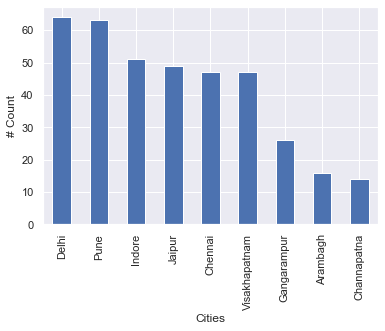

In [ ]:
# understand the different cities in Null states data
plt.figure()
df_events[dataE_Null_State]['city'].value_counts().plot.bar()
plt.ylabel("# Count")
plt.xlabel("Cities")
plt.show()

__Filling null States with correct values based on same City records and taking State from them__ 

In [ ]:
g=df_events.dropna(subset=['state']).drop_duplicates('city').set_index('city')['state']
#print(g)
df_events['state']=df_events['state'].fillna(df_events['city'].map(g))
#print(df_events[df_events['state'].isnull()])


__Checking if We have filled states__

In [ ]:
df_events.isnull().sum()

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state          0
dtype: int64

__States have been filled successfully__

In [ ]:
### Missing values treatment of Device ID, Longitude, Latitude and DeviceIDs

As we have already filled States now we will focus on filling Device ID, longitude and latitude. We are using Simple Imputer to fill the values.

### Using Simple Imputation

In [ ]:
dataE_Null_device_id = pd.isnull(df_events["device_id"])
df_events[dataE_Null_device_id]
df_events[dataE_Null_device_id].groupby(['city','state']).count()

,,event_id,device_id,timestamp,longitude,latitude
city,state,,,,,
Bardoli,Gujarat,16,0,16,16,16
Chennai,TamilNadu,63,0,63,63,63
Delhi,Delhi,69,0,69,69,69
Hoshiarpur,Punjab,16,0,16,16,16
Indore,MadhyaPradesh,51,0,51,51,51
Jaipur,Rajasthan,81,0,81,81,81
Jetpur,Gujarat,16,0,16,16,16
Pune,Maharashtra,72,0,72,72,72
Visakhapatnam,AndhraPradesh,69,0,69,69,69


__We have Device_id missing in above states events data. Maharashtra has only Pune with missing device IDs__

In [ ]:
dataE_Null_latlong = pd.isnull(df_events["latitude"])
df_events[dataE_Null_latlong]
df_events[dataE_Null_latlong].groupby(['city','state']).count()

,,event_id,device_id,timestamp,longitude,latitude
city,state,,,,,
Araria,Bihar,14,14,14,0,0
Bagaha,Bihar,14,14,14,0,0
Chennai,TamilNadu,63,63,63,0,0
Delhi,Delhi,63,63,63,0,0
Indore,MadhyaPradesh,63,63,63,0,0
Jaipur,Rajasthan,66,66,66,0,0
Moga,Punjab,14,14,14,0,0
Pune,Maharashtra,63,63,63,0,0
Visakhapatnam,AndhraPradesh,63,63,63,0,0


__We have missing values in States (Bihar, TamilNadu, Delhi, Madhyapradesh, Rajasthan, Punjab, Maharashtra and Haryana). Maharashtra has only Pune with missing latitude and longitude values__

In [ ]:
#g=df_events.dropna(subset=['longitude', 'latitude']).drop_duplicates(['city', 'state']).set_index(['city', 'state'])['longitude']
#print(g)
#df_events['longitude']=df_events['longitude'].fillna(df_events['city','state'].map(g))

In [ ]:
#from sklearn.impute import KNNImputer
#from sklearn.impute import KNNImputer

In [ ]:
df_impute=df_events.filter(['event_id','device_id','longitude','latitude'],axis=1)

In [ ]:
# Define the imputer
#knn_imputer = KNNImputer(n_neighbors=3, weights="uniform")

In [ ]:
# Transform the dataset
#transformed_values= knn_imputer.fit_transform(df_impute)

In [ ]:
#transformed_values.shape

In [ ]:
import numpy as np
from sklearn.impute import SimpleImputer

imr = SimpleImputer(missing_values=np.nan, strategy='most_frequent')

imr = imr.fit(df_impute.values)

imputed_data = imr.transform(df_impute.values)

print (imputed_data)

[[ 2.76536800e+06  2.97334779e+18  7.72256760e+01  2.87301400e+01]
 [ 2.95506600e+06  4.73422136e+18  8.83883610e+01  2.26603250e+01]
 [ 6.05968000e+05 -3.26449965e+18  7.72568090e+01  2.87579060e+01]
 ...
 [ 1.31622700e+06 -6.40604027e+18  7.72355780e+01  2.87640650e+01]
 [ 3.81262000e+05 -2.92074111e+18  8.33260440e+01  1.77654880e+01]
 [ 5.22592000e+05  3.21275047e+18  7.73085330e+01  9.77991800e+00]]


In [ ]:
df_filled = pd.DataFrame(data=imputed_data, columns=["event_id", "device_id","longitude","latitude"])

In [ ]:
df_filled.head()

,event_id,device_id,longitude,latitude
0,2765368.0,2.973348e+18,77.225676,28.730140
1,2955066.0,4.734221e+18,88.388361,22.660325
2,605968.0,-3.264500e+18,77.256809,28.757906
3,448114.0,5.731369e+18,80.343613,13.153332
4,665740.0,3.388880e+17,85.997745,23.842609


In [ ]:
df_filled.isna().sum()

event_id     0
device_id    0
longitude    0
latitude     0
dtype: int64

In [ ]:
print(df_events.info())
print(df_filled.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
event_id     int64
device_id    float64
timestamp    object
longitude    float64
latitude     float64
city         object
state        object
dtypes: float64(3), int64(1), object(3)
memory usage: 173.7+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 4 columns):
event_id     float64
device_id    float64
longitude    float64
latitude     float64
dtypes: float64(4)
memory usage: 99.3 MB
None


In [ ]:
df_imputed=pd.merge(df_events,df_filled,on=['event_id'])

In [ ]:
df_imputed.drop(['device_id_x', 'longitude_x', 'longitude_x'], axis=1, inplace=True)


In [ ]:
df_imputed.rename(columns={'device_id_y': 'device_id', 'longitude_y': 'longitude', 'latitude_y': 'latitude'}, inplace=True)

In [ ]:
df_imputed.head()

,event_id,timestamp,latitude_x,city,state,device_id,longitude,latitude
0,2765368,2016-05-07 22:52:05,28.730140,Delhi,Delhi,2.973348e+18,77.225676,28.730140
1,2955066,2016-05-01 20:44:16,22.660325,Calcutta,WestBengal,4.734221e+18,88.388361,22.660325
2,605968,2016-05-02 14:23:04,28.757906,Delhi,Delhi,-3.264500e+18,77.256809,28.757906
3,448114,2016-05-03 13:21:16,13.153332,Chennai,TamilNadu,5.731369e+18,80.343613,13.153332
4,665740,2016-05-06 03:51:05,23.842609,Bokaro,Jharkhand,3.388880e+17,85.997745,23.842609


In [ ]:
df_imputed.isna().sum()

event_id        0
timestamp       0
latitude_x    423
city            0
state           0
device_id       0
longitude       0
latitude        0
dtype: int64

In [ ]:
df_events = df_imputed
df_mh_final = df_imputed[df_imputed['state']=='Maharashtra']
print(df_events.info())
print(df_mh_final.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3252950 entries, 0 to 3252949
Data columns (total 8 columns):
event_id      int64
timestamp     object
latitude_x    float64
city          object
state         object
device_id     float64
longitude     float64
latitude      float64
dtypes: float64(4), int64(1), object(3)
memory usage: 223.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 677168 entries, 9 to 3252946
Data columns (total 8 columns):
event_id      677168 non-null int64
timestamp     677168 non-null object
latitude_x    677105 non-null float64
city          677168 non-null object
state         677168 non-null object
device_id     677168 non-null float64
longitude     677168 non-null float64
latitude      677168 non-null float64
dtypes: float64(4), int64(1), object(3)
memory usage: 46.5+ MB
None


__We have successfully filled missing values for Device_ids, logitude and latitude. Also ensured that we have not missed any records__ 

### <a id=section322></a> Outlier Detection and Removal

### Outlier Detection for Latitude and Longitude 

In [ ]:
# Creating subset for plotting latitude and longitude in map
dataE_map = df_mh_final[['latitude','longitude','city','state']]

# Counting number of duplicates of latitude and longitude
count1 = dataE_map.groupby(['latitude', 'longitude']).size() 
count = pd.DataFrame(count1)
count = count.rename(columns={0: 'DuplicateCounts'})
count.head()

,,DuplicateCounts
latitude,longitude,
13.128174,80.359796,63
16.703068,74.535110,35
16.716333,74.473859,4
16.716446,74.495842,9
16.718032,74.294617,2


In [ ]:
# Removing duplicated in the map data
dataE_map = dataE_map.drop_duplicates(keep='first')
dataE_map.describe(include='all')

,latitude,longitude,city,state
count,9014.000000,9014.000000,9014,9014
unique,NaN,NaN,87,1
top,NaN,NaN,Mumbai,Maharashtra
freq,NaN,NaN,4596,9014
mean,19.148230,73.915959,NaN,NaN
std,0.865473,1.817387,NaN,NaN
min,13.128174,12.567000,NaN,NaN
25%,18.778728,72.870048,NaN,NaN
50%,19.012954,72.914828,NaN,NaN
75%,19.056482,73.933384,NaN,NaN


In [ ]:
# merging the map data with count data to get the duplicatecounts of lat & long
dataE_map = pd.merge(left=dataE_map, right=count, on=['latitude', 'longitude'],how='left')
dataE_map.head(20)

,latitude,longitude,city,state,DuplicateCounts
0,18.974929,72.844795,Mumbai,Maharashtra,101
1,18.615791,73.875196,Pune,Maharashtra,936
2,18.619081,73.914179,Pune,Maharashtra,163
3,19.014537,72.874552,Mumbai,Maharashtra,168
4,18.582846,73.938826,Pune,Maharashtra,373
5,18.990110,72.859311,Mumbai,Maharashtra,36
6,19.990620,77.630324,Pusad,Maharashtra,168
7,21.255712,77.354427,Anjangaon,Maharashtra,173
8,19.014749,72.838406,Mumbai,Maharashtra,122
9,18.623336,73.929706,Pune,Maharashtra,277


In [ ]:
# Plotting latitude & longitude values in map using Folium
long_mode = st.mode(df_mh_final[df_mh_final.city == 'Pune']['longitude'])
lat_mode = st.mode(df_mh_final[df_mh_final.city == 'Pune']['latitude'])
map_vis = folium.Map(location=[lat_mode, long_mode], zoom_start=5, tiles='Stamen Terrain')
# Duplicates quartile is created to show different colors for different no. of duplicates
dataE_map['DuplicateCounts_quartile'] = pd.qcut(dataE_map['DuplicateCounts'], 4, labels=False)
# Color dictionary is created to distdf_mh_finalinguish the duplicates quartile (red shows more duplicates of lat & long data)
colordict = {0: 'blue', 1: 'green', 2: 'orange', 3: 'red'}

for lat, lon, Dc, Dc_q, city, state in zip(dataE_map['latitude'], dataE_map['longitude'], dataE_map['DuplicateCounts'], dataE_map['DuplicateCounts_quartile'], dataE_map['city'], dataE_map['state']):
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup = ('City: ' + str(city).capitalize() + '<br>'
                 'State: ' + str(state) + '<br>'
                 'Latitude: ' + str(lat) + '<br>'
                 'Longitude: ' + str(lon) + '<br>'
                 'Lat & Long DuplicateCounts: ' + str(Dc)
                ),
        color='b',
        key_on = Dc_q,
        threshold_scale=[0,1,2,3],
        fill_color=colordict[Dc_q],
        fill=True,
        fill_opacity=0.7
        ).add_to(map_vis)

In [ ]:
map_vis

__Visually, there are 3 location points (latitude,longitude) outside of Maharashtra (Located outside India). One near Dubai, one near Kabul and onr near Banglore__

In [ ]:
# Using latitude zscore value to extract the three latitude outliers (which are outside maharashtra)
dataE_map2 = dataE_map['latitude']
z = np.abs(stats.zscore(dataE_map2))
print(z)

[0.20024978 0.61523417 0.61143257 ... 1.0719853  0.11439258 0.17186374]


In [ ]:
# Finding the latitude values whose Zscore value > 3
dataE_map2 = dataE_map2[(z > 3)]
dataE_map2

2451    13.128174
6781    41.871900
7547    34.555300
8521    25.204800
Name: latitude, dtype: float64

In [ ]:
# Crosschecking the rows of identified latitudes in map data
dataE_map3 = dataE_map.isin({'latitude': dataE_map2})['latitude']
dataE_map3 = dataE_map[dataE_map3]
dataE_map3

,latitude,longitude,city,state,DuplicateCounts,DuplicateCounts_quartile
2451,13.128174,80.359796,Pune,Maharashtra,63,2
6781,41.871900,12.567000,Pune,Maharashtra,3,0
7547,34.555300,69.207500,Pune,Maharashtra,3,0
8521,25.204800,55.270800,Pune,Maharashtra,3,0


In [ ]:
# Plotting latitude & longitude values in map using Folium to crosscheck whether chosen latitude & longitude values are outside maharashtra
map_vis1 = folium.Map(location=[lat_mode, long_mode], zoom_start=5, tiles='Stamen Terrain')

for lat, lon in zip(dataE_map3['latitude'], dataE_map3['longitude']):
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup = ('Lat: ' + str(lat) + '<br>'
                 'Long: ' + str(lon) + '<br>'
        ),
        color='blue',
        fill=True,
        fill_opacity=0.7
        ).add_to(map_vis1)
map_vis1    

__It is confirmed visually that the chosen latitude & longitudes are outside Maharashtra Each chosen latitude & longitudes have  duplicates which means there are more data points which need to be changed All chosen latitude & longitudes are in Pune location so these can be replaced with mode values of Pune's latitude & longitude__

In [ ]:
import statistics as st
from scipy import stats
# Using latitude zscore value to extract the three latitude outliers (which are outside maharashtra)

df_events_map = df_events[['latitude','longitude','city','state']]
#df_events_map = df_events_map.drop_duplicates(keep='first')
# Counting number of duplicates of latitude and longitude

count1 = df_events_map.groupby(['latitude', 'longitude']).size() 
count = pd.DataFrame(count1)
count = count.rename(columns={0: 'DuplicateCounts'})
print(count.head())
df_events_map = pd.merge(left=df_events_map, right=count, on=['latitude', 'longitude'],how='left')
display(df_events_map)

dataE_map2 = df_events_map['latitude']
display(dataE_map2)
z = np.abs(stats.zscore(dataE_map2
                       ))
print(z)

                    DuplicateCounts
latitude longitude                 
8.190110 77.511124                3
8.193192 77.466580               36
8.199913 77.441830                5
8.200381 77.521803                1
8.200689 77.487619                2


,latitude,longitude,city,state,DuplicateCounts
0,28.730140,77.225676,Delhi,Delhi,194
1,22.660325,88.388361,Calcutta,WestBengal,47
2,28.757906,77.256809,Delhi,Delhi,130
3,13.153332,80.343613,Chennai,TamilNadu,3513
4,23.842609,85.997745,Bokaro,Jharkhand,46
...,...,...,...,...,...
3252945,18.544124,73.891597,Pune,Maharashtra,1325
3252946,19.018432,72.837258,Mumbai,Maharashtra,40
3252947,28.764065,77.235578,Delhi,Delhi,74
3252948,17.765488,83.326044,Visakhapatnam,AndhraPradesh,203


0          28.730140
1          22.660325
2          28.757906
3          13.153332
4          23.842609
             ...    
3252945    18.544124
3252946    19.018432
3252947    28.764065
3252948    17.765488
3252949     9.779918
Name: latitude, Length: 3252950, dtype: float64

[1.21645566 0.16804817 1.22125153 ... 1.22231535 0.6774115  2.05671736]


In [ ]:
# Finding the latitude values whose Zscore value > 3
dataE_map2 = dataE_map2[(z > 3)]
dataE_map2

82827      41.8719
91260      41.8719
144191     41.8719
218308     41.8719
245718     41.8719
291818     41.8719
666553     41.8719
812011     41.8719
950601     41.8719
1101656    41.8719
1265395    41.8719
1462160    41.8719
1514689    41.8719
1550112    41.8719
1598260    41.8719
1630122    41.8719
2029146    41.8719
2055160    41.8719
2205965    41.8719
2207461    41.8719
2460768    41.8719
Name: latitude, dtype: float64

In [ ]:
df_events.head()

,event_id,timestamp,latitude_x,city,state,device_id,longitude,latitude
0,2765368,2016-05-07 22:52:05,28.730140,Delhi,Delhi,2.973348e+18,77.225676,28.730140
1,2955066,2016-05-01 20:44:16,22.660325,Calcutta,WestBengal,4.734221e+18,88.388361,22.660325
2,605968,2016-05-02 14:23:04,28.757906,Delhi,Delhi,-3.264500e+18,77.256809,28.757906
3,448114,2016-05-03 13:21:16,13.153332,Chennai,TamilNadu,5.731369e+18,80.343613,13.153332
4,665740,2016-05-06 03:51:05,23.842609,Bokaro,Jharkhand,3.388880e+17,85.997745,23.842609


### Outlier Detection and Removal in Age data for Age

In [ ]:
#Importing plotly library
import plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

In [ ]:
#checking the outliers using Box Plot
plot_data = [
    go.Box(
        x=df_gen_age_train['age'],fillcolor='rgba(219, 64, 82, 0.6)',)]

plot_layout = go.Layout(
        title='Age')
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

__As we can see from above plot that minimum age is 1 and maximum age is 96. Median age is close to 30 years. 75% of users are below 40 years of age.__

In [ ]:
# Isolation Forest method to handle outliers.
df_gen_age_train.columns
#specify the metrics column names to be modelled
to_model_columns=df_gen_age_train.columns[2:-1]
from sklearn.ensemble import IsolationForest
clf=IsolationForest(n_estimators=50, max_samples='auto', contamination=float(.01), #contamination='auto'
                        max_features=1.0, bootstrap=False, n_jobs=-1, random_state=42, verbose=0) # n_jobs=-1, random_state=42

clf.fit(df_gen_age_train[to_model_columns])
pred = clf.predict(df_gen_age_train[to_model_columns])
df_gen_age_train['anomaly']=pred

np.unique(pred)
outliers=df_gen_age_train.loc[df_gen_age_train['anomaly']==-1]
outlier_index=list(outliers.index)

#Find the number of anomalies and normal points here points classified -1 are anomalous
print(df_gen_age_train['anomaly'].value_counts())


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:415: DeprecationWarning:

threshold_ attribute is deprecated in 0.20 and will be removed in 0.22.



 1    73913
-1      732
Name: anomaly, dtype: int64


### Removing Outliers

In [ ]:
df_gen_age_train=df_gen_age_train[df_gen_age_train['anomaly']!=-1]
df_gen_age_train.shape

(73913, 5)

__once again verifying outlier by using  box plot__

In [ ]:
#once again verifying outlier by using  box plot 
plot_data = [
    go.Box(
        x=df_gen_age_train['age'],fillcolor='rgba(219, 64, 82, 0.6)',)]

plot_layout = go.Layout(
        title='Age')
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

__After removing Outliers we have reasonable age values in our dataset__

###  <a id=section323></a> Chinese Character Treatment

### Chinese to English Translation for Brand Names

In [ ]:
# Getting the unique values in phone_brand data
df_dev_model.phone_brand.unique()

array(['vivo', '小米', 'OPPO', '三星', '酷派', '联想 ', '华为', '奇酷', '魅族', '斐讯',
       '中国移动', 'HTC', '天语', '至尊宝', 'LG', '欧博信', '优米', 'ZUK', '努比亚', '惠普',
       '尼比鲁', '美图', '乡米', '摩托罗拉', '梦米', '锤子', '富可视', '乐视', '海信', '百立丰',
       '一加', '语信', '海尔', '酷比', '纽曼', '波导', '朵唯', '聆韵', 'TCL', '酷珀', '爱派尔',
       'LOGO', '青葱', '果米', '华硕', '昂达', '艾优尼', '康佳', '优购', '邦华', '赛博宇华',
       '黑米', 'Lovme', '先锋', 'E派', '神舟', '诺基亚', '普耐尔', '糖葫芦', '亿通', '欧新',
       '米奇', '酷比魔方', '蓝魔', '小杨树', '贝尔丰', '糯米', '米歌', 'E人E本', '西米', '大Q',
       '台电', '飞利浦', '唯米', '大显', '长虹', '维图', '青橙', '本为', '虾米', '夏新', '帷幄',
       '百加', 'SUGAR', '欧奇', '世纪星', '智镁', '欧比', '基伍', '飞秒', '德赛', '易派',
       '谷歌', '金星数码', '广信', '诺亚信', 'MIL', '白米', '大可乐', '宝捷讯', '优语', '首云',
       '瑞米', '瑞高', '沃普丰', '摩乐', '鲜米', '凯利通', '唯比', '欧沃', '丰米', '恒宇丰',
       '奥克斯', '西门子', '欧乐迪', 'PPTV'], dtype=object)

In [ ]:
# Creating dictionary of chinese to english phone brands
brands_in_chinese = ['vivo', '小米', 'OPPO', '三星', '酷派', '联想 ', '华为', '奇酷', '魅族', '斐讯',
       '中国移动', 'HTC', '天语', '至尊宝', 'LG', '欧博信', '优米', 'ZUK', '努比亚', '惠普',
       '尼比鲁', '美图', '乡米', '摩托罗拉', '梦米', '锤子', '富可视', '乐视', '海信', '百立丰',
       '一加', '语信', '海尔', '酷比', '纽曼', '波导', '朵唯', '聆韵', 'TCL', '酷珀', '爱派尔',
       'LOGO', '青葱', '果米', '华硕', '昂达', '艾优尼', '康佳', '优购', '邦华', '赛博宇华',
       '黑米', 'Lovme', '先锋', 'E派', '神舟', '诺基亚', '普耐尔', '糖葫芦', '亿通', '欧新',
       '米奇', '酷比魔方', '蓝魔', '小杨树', '贝尔丰', '糯米', '米歌', 'E人E本', '西米', '大Q',
       '台电', '飞利浦', '唯米', '大显', '长虹', '维图', '青橙', '本为', '虾米', '夏新', '帷幄',
       '百加', 'SUGAR', '欧奇', '世纪星', '智镁', '欧比', '基伍', '飞秒', '德赛', '易派',
       '谷歌', '金星数码', '广信', '诺亚信', 'MIL', '白米', '大可乐', '宝捷讯', '优语', '首云',
       '瑞米', '瑞高', '沃普丰', '摩乐', '鲜米', '凯利通', '唯比', '欧沃', '丰米', '恒宇丰',
       '奥克斯', '西门子', '欧乐迪', 'PPTV']
brands_in_english = ['vivo','Xiaomi','OPPO','Samsung','Cool','Lenovo','Huawei','Qiku','Meizu','Fixuns',
'China Mobile','HTC','Tianyu','Supreme Treasure','LG','Obson','Umi','ZUK','Nubia','HP',
'Nibiru','Meitu','Xianmi','Motorola','Mengmi','Hammer','Focus','LeTV','Hisense','Baifeng', 
'One Plus','Letter','Haier','Coolby','Newman','Wave','Duowei','Listening Rhyme','TCL','Cupper','Aipal ',
'LOGO','Green Onion','Guomi','ASUS','Onda','Ai Youni','Konka','Yougo','Banghua','Saibo Yuhua',
'Black Rice','Lovme','Pioneer','E Pie','Shenzhou','Nokia','Pnell','Candied Gourd','Yitong','Osin',
'Mickey','Rubiks Cube','Blue Devil','Little Poplar','Belfong','Glutinous Rice','Mige','Eren Eben','Simi','Big Q' ,'Taipower','Philips','Wei Mi','Da Xian','Changhong','Weitu','Green Orange','Original','Shrimp','Xia Xin','Xiao','Baiga','SUGAR','Ouqi','Century Star','Chi Magnesium','Obi','Kivu','Femtosecond','Desai','Epai',
'Google','Venus Digital','Guangxin','Noah','MIL','Bai Mi','Big Cola','Bao Jie Xun','Youyu','Shouyun',
'Rumi','Rigao','Wopfung','Mole','Fresh Rice','Kellystone','Vibe','Ovo','Fungmi','Hengyufeng ',
'Aux','Siemens','Oledi','PPTV']

brands_dict1 = dict(zip(brands_in_chinese, brands_in_english))
# Chinese words in phone_brand data in converted to english using lambda function
df_dev_model.phone_brand = df_dev_model.phone_brand.apply(lambda val: brands_dict1[val] if val in brands_dict1 else val)

### Chinese to English Translation for Device Model

In [ ]:
# Finding the unique chinese words in the device_model data using "re" library
import re
def dmodel_Chinese(dev_model): 
    for x in dev_model: 
        if re.search("[\u4e00-\u9FFF]", x):
            chinese_dmodel.append(x)
    return chinese_dmodel

chinese_dmodel = []
chinese_dmodel = dmodel_Chinese(df_dev_model.device_model)
chinese_dmodel = set(chinese_dmodel)
print(chinese_dmodel)

{'大观铂顿', '荣耀4A', '荣耀畅玩4X', '坚果手机', '野火S', '小辣椒 X3', '么么哒3S', '魅蓝2', '乐檬K31', '荣耀6 Plus', '荣耀6', '醉享', '荣耀畅玩4C运动版', '黄金斗士青春版', '青漾3', '远航3', 'note顶配版', '乐玩2C', '小辣椒 7', '春雷HD', '大器2', '小苹果', '领世旗舰3', '星星2号', '大神F1', '倾城L3', '小鲜3', '2016版 Galaxy A7', '大神F2', '么么哒', '小章鱼', 'Xperia Z1 炫彩版', '乐檬K3', '小星星', '飞马', '红牛V5', '小鲜2', '大神F1Plus', '小辣椒 6', '大观4', '么么哒3N', '魔镜 X5', '天鉴W808', '大神1s', '微客', '威武3', '红辣椒', '火星一号', '魅蓝', '红米2', '大Q Note', '红米Note2', '超级手机1', '红辣椒 X1', '大神Note3', '超级手机Max', '小米4C', '锋尚2', '红米', '锋尚Pro', '红辣椒XM', '红辣椒任性版 Plus', '红辣椒NX Plus', 'Moto X极', '小辣椒 M3', '荣耀畅玩4', 'metal 标准版', '大神F2全高清版', '旋影90w', '麦芒4', 'Razr V锋芒', 'ivvi 小i', '红米1S', '风华3', '飞马3', '麦芒3', '火星一号探索版', '雷霆战机', '荣耀7', '荣耀U8860', '小辣椒X4', '荣耀畅玩5X', '小辣椒 M2', '荣耀6 plus', '炫影S+', '畅享5', '荣耀X2', '麦芒3S', '2016版 Galaxy J7', '乐檬X3', '乐檬3', '小米note', '荣耀3C畅玩版', '乐玩', '纽扣', '畅享5S', '荣耀畅玩5', '超级手机1s', '黄金斗士Note8', '威武3C', '荣耀3X', '大神X7', 'Z9 mini 精英版', '飞马2 Plus', 'Axon天机', '土星一号', '锋尚', '小辣椒S1', '旗舰版', '小辣椒 9', '

In [ ]:
# Creating dictionary of chinese to english device models
device_in_chinese = ['乐檬3', '飞马3', 'ivvi 小i', '2016版 Galaxy A5', 'Z9 mini 精英版', '金刚II', '小辣椒 9', 
                     '锋尚2', 'Xperia Z1 炫彩版', '天鉴W900', '小鲜3', '大观铂顿', '威武3', '荣耀U8860', '联想VIBE X2', 
                     '青漾3', '红辣椒XM', '小辣椒 6', '小辣椒 4', '小辣椒 7', 'metal 标准版', 'My 布拉格', '大神Note', 
                     '红米3', '荣耀畅玩4C', '金钢', '超级手机1', '三星big foot', '黄金斗士Note8', 'note顶配版', '飞马2 Plus', 
                     '小鲜2', '大神F2', '么么哒3N', '红米2', '大神1s', '红辣椒NX Plus', '天鉴W900S', '大神F2全高清版', 
                     '星星1号', '乐檬K31', '荣耀7i', 'Razr V锋芒', '黄金斗士S8畅玩版', 'ivvi 小骨Pro', '小章鱼', '么么哒3S', 
                     '锋尚Max', '小辣椒 5', '荣耀6 Plus', '坚果手机', '2016版 Galaxy A7', '黄金斗士A8', '魅蓝NOTE', 
                     'TALK 7X四核', '小辣椒X4', '荣耀X2', '联想黄金斗士S8', '大Q Note', '荣耀平板T1-823L', '乐玩', '乐檬X3', 
                     '荣耀6 plus', '魅蓝', '畅享5', '火星一号', '魅蓝metal', '乐檬K3', '荣耀6', '雷霆战机', '荣耀3C畅玩版', 
                     '荣耀7', '魔镜 X5', '小辣椒 M2', '大观4', '微客', '荣耀4A', '领世旗舰3', '2016版 Galaxy A9', 
                     '黄金斗士青春版', '荣耀畅玩5X', '青春版', '春雷HD', '远航3', '7295A青春版', '时尚手机', '乐檬K3 Note', 
                     '倾城L3C', '小苹果', '荣耀+', 'Axon天机', '荣耀3X畅玩版', '红米Note2', '红米', '红辣椒 X1', '大神F1Plus', 
                     '红米note', '麦芒3', '锋尚Pro', '炫影S+', '醉享', '荣耀畅玩4X', '红米note增强版', '渴望HD', '倾城L3', 
                     '灵感XL', '畅享5S', '威武3C', '天鉴W808', '荣耀畅玩4C运动版', '小辣椒S1', 'Moto X极', '红米Note3', 
                     '超级手机1 Pro', '小星星', '大器3', '魅蓝Note 2', '锋尚', '乐玩2C', '小辣椒 X3', '旋影90w', '荣耀畅玩4', 
                     '魅蓝2', '旗舰版', '荣耀畅玩5', 'Mate 7 青春版', '火星一号探索版', '天鉴T1', '红牛V5', '荣耀畅玩平板T1', 
                     '红辣椒', '大器2', '风华3', '土星一号', '魅蓝Note3', '荣耀3X', '红辣椒Note3', '大神Note3', '麦芒3S', 
                     '红米1S', '麦芒4', '大神X7', '小米note', '飞马', '红辣椒任性版 Plus', '小辣椒 M3', '么么哒', '小辣椒 3', 
                     'T03锋至版', '星星2号', '大神F1', '红米2A', '小米4C', '纽扣', '红辣椒Note', '野火S', '中兴远航3', 
                     '超级手机1s', '超级手机Max', '2016版 Galaxy J7', '荣耀3C']
device_in_english = ['Le Meng 3','Pegasus 3','ivvi Little i', '2016 version of Galaxy A5','Z9 mini Elite','Vajra II',
                     'Little Pepper 9','Feng Shang 2', ' Xperia Z1 Colorful Edition','Tianjian W900','Xiao Xian 3',
                     'Grand View Platinum','Mighty 3','Honor U8860','Lenovo VIBE X2','Blue 3','Red Pepper XM',
                     'Little Pepper 6','Little Pepper 4','Little Pepper 7','Metal Standard','My Prague','Great God Note',
                     'Redmi 3','Honor Play 4C', 'Jin Gang','Super Phone 1','Samsung big foot','Golden Fighter Note8',
                     'note top version','Pegasus 2 Plus','Xiao Xian 2','Great God F2', ' Me Da 3N','Redmi 2',
                     'Great God 1s','Red Pepper NX Plus','Tianjian W900S','Great God F2 Full HD Version','Star 1',
                     'Le Lemon K31', ' Glory 7i','Razr V Fengmang','Golden Fighter S8 Play Edition','ivvi Little Bone Pro',
                     'Little Octopus','Mo Mo Da 3S','Feng Shang Max','Little Pepper 5', ' Honor 6 Plus','Nuts Phone', 
                     '2016 Galaxy A7','Golden Fighter A8','Charm Blue NOTE','TALK 7X Quad Core','Little Pepper X4',
                     'Honor X2','Lenovo Gold Gladiator S8','Big Q Note','Honor Tablet T1-823L','Lewan','Lemon X3',
                     'Honor 6 plus','Charm Blue','Enjoy 5','Mars One ','Charm Blue Metal','Le Meng K3','Honor 6',
                     'Thunder Fighter','Honor 3C Play Edition','Honor 7','Magic Mirror X5','Little Pepper M2', 
                     'Daguan 4','Weike','Glory 4A','Leadership Flagship 3', '2016 Galaxy A9','Golden Fighter Youth Edition',
                     'Glory Play 5X','Youth Edition','Spring Lei HD','Yuanhang 3', '7295A Youth Edition','Fashion Phone',
                     'Le Meng K3 Note','Qingcheng L3C','Little Apple','Glory+','Axon Sky Machine',
                     'Glory 3X Chang Play Edition','Redmi Note2','Redmi','Red Pepper X1','Great God F1Plus',
                     'Redmi Note','Mai Mang 3','Feng Shang Pro','Hyun Shadow S+', ' Drunken Enjoy','Honor Play 4X',
                     'Redmi Note Enhanced Edition','Longing HD','Allure L3','Inspiration XL','Enjoy 5S','Powerful 3C',
                     'Tianjian W808' ,'Honor Play 4C Sports Edition','Little Pepper S1','Moto X Pole','Redmi Note3',
                     'Super Phone 1 Pro','Little Star','Big 3','Charm Blue Note 2','Feng Shang','Lewan 2C',
                     'Little Pepper X3','Xuanying 90w','Honor Play 4','Charm Blue 2','Flagship','Honor Play 5' ,
                     'Mate 7 Youth Edition','Mars One Exploration Edition','Tianjian T1','Red Bull V5','Honor Play T1',
                     'Red Chili','Big 2','Fenghua 3' ,'Saturn One','Charm Blue Note3','Glory 3X','Red Chili Note3',
                     'Great God Note3','Maimang 3S','Redmi 1S','Maimang 4','Great God X7', 'Xiaomi Note','Pegasus',
                     'Red Pepper Capricious Edition Plus','Little Pepper M3','Mo Mo Da','Little Pepper 3',
                     'T03 Fengzhi Edition','Xingxing 2', ' Great God F1','Redmi 2A','Xiaomi 4C','Button',
                     'Red Chili Note','Wildfire S','ZTE Voyage 3','Super Phone 1s','Super Phone Max', 
                     '2016 Edition Galaxy J7','Honor 3C']

device_dict1 = dict(zip(device_in_chinese, device_in_english))
# Checking top 20 device_models before converting to English (used for crosschecking)
df_dev_model.device_model.value_counts().head(20)

红米note           3500
MI 3             2739
MI 2S            2547
Galaxy Note 3    2378
MI 4             2256
Galaxy S4        1910
Galaxy Note 2    1877
荣耀6              1471
荣耀畅玩4X           1279
荣耀3C             1206
红米1S             1191
红米               1168
Galaxy S3        1156
Mate 7           1125
魅蓝NOTE           1026
红米2               941
红米Note2           903
MX3               842
Galaxy S5         827
荣耀6 Plus          815
Name: device_model, dtype: int64

In [ ]:
# Chinese words in device_model data in converted to english using lambda function
df_dev_model.device_model = df_dev_model.device_model.apply(lambda val: device_dict1[val] if val in device_dict1 else val)
# Crosschecking whether chinese words in phone_brand data is changed to english
df_dev_model.device_model.value_counts().head(20)

Redmi Note         3500
MI 3               2739
MI 2S              2547
Galaxy Note 3      2378
MI 4               2256
Galaxy S4          1910
Galaxy Note 2      1877
Honor 6            1471
Honor Play 4X      1279
Honor 3C           1206
Redmi 1S           1191
Redmi              1168
Galaxy S3          1156
Mate 7             1125
Charm Blue NOTE    1026
Redmi 2             941
Redmi Note2         903
MX3                 842
Galaxy S5           827
 Honor 6 Plus       815
Name: device_model, dtype: int64

__All chinese words in device_model data is changed to english__

### <a id=section324></a>  Feature Engineering the Event Timestamp

In [ ]:
# Filter the data of Maharashtra State
df_mh = df_events[df_events['state'] == 'Maharashtra']
display(df_mh.head())
print(" ")
print("*******************Info of Dataframe***********************")
print(df_mh.info())

,event_id,timestamp,latitude_x,city,state,device_id,longitude,latitude
9,720049,2016-05-06 19:00:52,18.974929,Mumbai,Maharashtra,4.928556e+18,72.844795,18.974929
11,13998,2016-05-06 13:12:42,18.615791,Pune,Maharashtra,3.978026e+18,73.875196,18.615791
20,1378252,2016-05-05 04:20:02,18.619081,Pune,Maharashtra,-4.384474e+18,73.914179,18.619081
21,185325,2016-05-02 20:07:07,19.014537,Mumbai,Maharashtra,-7.369690e+18,72.874552,19.014537
22,1861432,2016-05-02 20:49:13,18.582846,Pune,Maharashtra,3.965811e+18,73.938826,18.582846


 
*******************Info of Dataframe***********************
<class 'pandas.core.frame.DataFrame'>
Int64Index: 677168 entries, 9 to 3252946
Data columns (total 8 columns):
event_id      677168 non-null int64
timestamp     677168 non-null object
latitude_x    677105 non-null float64
city          677168 non-null object
state         677168 non-null object
device_id     677168 non-null float64
longitude     677168 non-null float64
latitude      677168 non-null float64
dtypes: float64(4), int64(1), object(3)
memory usage: 46.5+ MB
None


In [ ]:
#creating a copy of cleaned Data for Maharashtra

df_mh_event=df_mh.groupby(['device_id'])['event_id'].unique().reset_index()
df_mh_event.shape
df_mh_event.head()

,device_id,event_id
0,-9.221046e+18,[231495]
1,-9.216966e+18,"[1461038, 2164118, 2536392, 2976373, 1732358, ..."
2,-9.213678e+18,"[2912516, 2665445, 2412507, 963012, 1854369, 1..."
3,-9.205811e+18,"[262836, 1230019, 2570142, 710535, 1545742, 29..."
4,-9.205529e+18,"[424290, 2312803, 1268740, 400394, 3051539, 32..."


In [ ]:
df_event_loc=df_mh.loc[df_mh.groupby(['device_id'])['longitude'].idxmin()]
df_event_loc.shape
df_event_loc.head(10)                    

,event_id,timestamp,latitude_x,city,state,device_id,longitude,latitude
1541384,231495,2016-05-06 17:05:02,18.618607,Diglur,Maharashtra,-9.221046e+18,77.626298,18.618607
10006,1461038,2016-05-03 20:48:01,18.566741,Pune,Maharashtra,-9.216966e+18,73.930039,18.566741
22398,2912516,2016-05-02 15:04:18,21.093343,Amalner,Maharashtra,-9.213678e+18,75.072412,21.093343
180834,262836,2016-05-02 21:01:51,18.590806,Pune,Maharashtra,-9.205811e+18,73.913144,18.590806
663270,424290,2016-05-06 02:42:33,19.323448,MiraBhayandar,Maharashtra,-9.205529e+18,72.868457,19.323448
338027,1924821,2016-05-05 07:51:38,19.018807,Mumbai,Maharashtra,-9.202108e+18,72.895741,19.018807
92915,2509917,2016-05-04 09:55:21,18.621292,Pune,Maharashtra,-9.187518e+18,73.906851,18.621292
33417,2003253,2016-05-01 18:42:39,18.543685,Pune,Maharashtra,-9.187300e+18,73.902746,18.543685
12847,204549,2016-05-01 15:03:11,19.043532,Mumbai,Maharashtra,-9.185683e+18,72.888473,19.043532
161091,570543,2016-05-07 07:46:08,19.017163,Mumbai,Maharashtra,-9.185115e+18,72.898543,19.017163


In [ ]:
df_mh_longitude=df_mh.groupby(['city'])['longitude'].unique()
df_mh_longitude

city
Achalpur      [77.553179, 77.548171, 77.51239699999998, 77.5...
Ahmadnagar    [74.800333, 74.833638, 74.806421, 74.837406, 7...
Akola         [77.033621, 77.09803199999998, 77.034598, 77.0...
Akot          [77.149917, 77.11539599999998, 77.065846999999...
Amalner       [75.082668, 75.09565400000002, 75.072742, 75.1...
                                    ...                        
Wani          [79.02288, 78.975595, 78.96239800000002, 79.02...
Wardha        [78.639344, 78.668872, 78.62853899999998, 78.6...
Warud         [78.35549999999998, 78.34260400000002, 78.2835...
Washim        [77.17455600000002, 77.217224, 77.164434, 77.2...
Yavatmal      [78.19970099999998, 78.163096, 78.178984, 78.2...
Name: longitude, Length: 87, dtype: object

- event_id is a primary key as all the observations has unique event_id

In [ ]:
group_mh=df_mh['device_id'].value_counts().reset_index().sort_values(by='index')
group_mh.columns=['device_id','Count']
group_mh

,device_id,Count
8836,-9.221046e+18,1
105,-9.216966e+18,570
3158,-9.213678e+18,59
3005,-9.205811e+18,63
7640,-9.205529e+18,6
...,...,...
7530,9.214609e+18,6
2265,9.215049e+18,85
4017,9.217862e+18,43
4932,9.219842e+18,30


In [ ]:
#converting the type of Date Field from string object to datetime.
df_mh['timestamp'] = pd.to_datetime(df_mh['timestamp'])

In [ ]:
#coerce the date, month and year from timestamp column 
df_mh['date']=df_mh['timestamp'].dt.day
df_mh['month']=df_mh['timestamp'].dt.month
df_mh['year']=df_mh['timestamp'].dt.year
df_mh['hour']=df_mh['timestamp'].dt.hour

In [ ]:
df_mh.head()

,event_id,timestamp,latitude_x,city,state,device_id,longitude,latitude,date,month,year,hour
9,720049,2016-05-06 19:00:52,18.974929,Mumbai,Maharashtra,4.928556e+18,72.844795,18.974929,6,5,2016,19
11,13998,2016-05-06 13:12:42,18.615791,Pune,Maharashtra,3.978026e+18,73.875196,18.615791,6,5,2016,13
20,1378252,2016-05-05 04:20:02,18.619081,Pune,Maharashtra,-4.384474e+18,73.914179,18.619081,5,5,2016,4
21,185325,2016-05-02 20:07:07,19.014537,Mumbai,Maharashtra,-7.369690e+18,72.874552,19.014537,2,5,2016,20
22,1861432,2016-05-02 20:49:13,18.582846,Pune,Maharashtra,3.965811e+18,73.938826,18.582846,2,5,2016,20


__Now we have understood the data, cleanup, filled missing values, performed data translation and added a few columns for our analysis we are ready to anwer questions through data visualization__

__We will make a final dataframe by merging all three datasets only for Maharashtra__

In [ ]:
df_left_merge=pd.merge(df_dev_model,df_mh,how="inner",on="device_id") 
df_left_merge_all=pd.merge(df_dev_model,df_events,how="inner",on="device_id") 
df_left_merge.info()
df_left_merge_all.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 677168 entries, 0 to 677167
Data columns (total 14 columns):
device_id       677168 non-null float64
phone_brand     677168 non-null object
device_model    677168 non-null object
event_id        677168 non-null int64
timestamp       677168 non-null datetime64[ns]
latitude_x      677105 non-null float64
city            677168 non-null object
state           677168 non-null object
longitude       677168 non-null float64
latitude        677168 non-null float64
date            677168 non-null int64
month           677168 non-null int64
year            677168 non-null int64
hour            677168 non-null int64
dtypes: datetime64[ns](1), float64(4), int64(5), object(4)
memory usage: 77.5+ MB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 3252950 entries, 0 to 3252949
Data columns (total 10 columns):
device_id       float64
phone_brand     object
device_model    object
event_id        int64
timestamp       object
latitude_x      float64
ci

In [ ]:
#df_merge_mh=pd.merge(df_dev_model,df_mh,how="inner",on="device_id") 
df_merge_mh=pd.merge(df_left_merge,df_gen_age_train,how="left",on="device_id")
df_merge_all=pd.merge(df_left_merge_all,df_gen_age_train,how="left",on="device_id")

df_merge_mh.info()
display(df_merge_mh.head())
df_merge_mh['device_id'].nunique()

df_merge_all.info()
display(df_merge_all.head())
df_merge_all['device_id'].nunique()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 677168 entries, 0 to 677167
Data columns (total 18 columns):
device_id       677168 non-null float64
phone_brand     677168 non-null object
device_model    677168 non-null object
event_id        677168 non-null int64
timestamp       677168 non-null datetime64[ns]
latitude_x      677105 non-null float64
city            677168 non-null object
state           677168 non-null object
longitude       677168 non-null float64
latitude        677168 non-null float64
date            677168 non-null int64
month           677168 non-null int64
year            677168 non-null int64
hour            677168 non-null int64
gender          671198 non-null object
age             671198 non-null float64
group           671198 non-null object
anomaly         671198 non-null float64
dtypes: datetime64[ns](1), float64(6), int64(5), object(6)
memory usage: 98.2+ MB


,device_id,phone_brand,device_model,event_id,timestamp,latitude_x,city,state,longitude,latitude,date,month,year,hour,gender,age,group,anomaly
0,-9.216966e+18,Xiaomi,MI 2S,1461038,2016-05-03 20:48:01,18.566741,Pune,Maharashtra,73.930039,18.566741,3,5,2016,20,M,29.0,M29-31,1.0
1,-9.216966e+18,Xiaomi,MI 2S,2164118,2016-05-03 19:30:19,18.566741,Pune,Maharashtra,73.930039,18.566741,3,5,2016,19,M,29.0,M29-31,1.0
2,-9.216966e+18,Xiaomi,MI 2S,2536392,2016-05-03 23:30:30,18.566741,Pune,Maharashtra,73.930039,18.566741,3,5,2016,23,M,29.0,M29-31,1.0
3,-9.216966e+18,Xiaomi,MI 2S,2976373,2016-05-03 15:30:08,18.566741,Pune,Maharashtra,73.930039,18.566741,3,5,2016,15,M,29.0,M29-31,1.0
4,-9.216966e+18,Xiaomi,MI 2S,1732358,2016-05-03 21:19:21,18.566741,Pune,Maharashtra,73.930039,18.566741,3,5,2016,21,M,29.0,M29-31,1.0


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3252950 entries, 0 to 3252949
Data columns (total 14 columns):
device_id       float64
phone_brand     object
device_model    object
event_id        int64
timestamp       object
latitude_x      float64
city            object
state           object
longitude       float64
latitude        float64
gender          object
age             float64
group           object
anomaly         float64
dtypes: float64(6), int64(1), object(7)
memory usage: 372.3+ MB


,device_id,phone_brand,device_model,event_id,timestamp,latitude_x,city,state,longitude,latitude,gender,age,group,anomaly
0,2.451335e+17,SUGAR,Fashion Phone,1051738,2016-05-07 20:09:19,27.575918,Mathura,UttarPradesh,77.738434,27.575918,M,30.0,M29-31,1.0
1,2.451335e+17,SUGAR,Fashion Phone,1620945,2016-05-07 20:10:19,27.575918,Mathura,UttarPradesh,77.738434,27.575918,M,30.0,M29-31,1.0
2,2.451335e+17,SUGAR,Fashion Phone,2132492,2016-05-07 20:13:57,27.575918,Mathura,UttarPradesh,77.738434,27.575918,M,30.0,M29-31,1.0
3,2.451335e+17,SUGAR,Fashion Phone,2745095,2016-05-07 20:10:49,27.575918,Mathura,UttarPradesh,77.738434,27.575918,M,30.0,M29-31,1.0
4,-8.098239e+18,Xiaomi,MI 2S,1198750,2016-05-01 10:07:21,29.233859,Hisar,Haryana,75.756168,29.233859,M,38.0,M32-38,1.0


60865

### Ensuring Age groups have correct classification

In [ ]:
labels=df_gen_age_train['group'].unique()
print(labels)
print(df_gen_age_train.info())

print(df_gen_age_train.groupby('group').count())

print("*****************************Calculated Check of Age Group*******************")
print("M32-38: ",df_gen_age_train[(df_gen_age_train['age']>=32) & (df_gen_age_train['age']<=38) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("M29-31: ",df_gen_age_train[(df_gen_age_train['age']>=29) & (df_gen_age_train['age']<=31) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("F24-26: ",df_gen_age_train[(df_gen_age_train['age']>=24) & (df_gen_age_train['age']<=26) & (df_gen_age_train['gender']=="F")]["device_id"].count())
print("F33-42: ",df_gen_age_train[(df_gen_age_train['age']>=33) & (df_gen_age_train['age']<=42) & (df_gen_age_train['gender']=="F")]["device_id"].count())
print("F27-28: ",df_gen_age_train[(df_gen_age_train['age']>=27) & (df_gen_age_train['age']<=28) & (df_gen_age_train['gender']=="F")]["device_id"].count())
print("M39+: ",df_gen_age_train[(df_gen_age_train['age']>=39) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("M23-26: ",df_gen_age_train[(df_gen_age_train['age']>=23) & (df_gen_age_train['age']<=26) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("M27-28: ",df_gen_age_train[(df_gen_age_train['age']>=27) & (df_gen_age_train['age']<=28) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("M22-: ",df_gen_age_train[(df_gen_age_train['age']<=22) & (df_gen_age_train['gender']=="M")]["device_id"].count())
print("F43+: ",df_gen_age_train[(df_gen_age_train['age']>=43) & (df_gen_age_train['gender']=="F")]["device_id"].count())
print("F23-: ",df_gen_age_train[(df_gen_age_train['age']<=23) & (df_gen_age_train['gender']=="F")]["device_id"].count())
print("F29-32: ",df_gen_age_train[(df_gen_age_train['age']>=29) & (df_gen_age_train['age']<=32) & (df_gen_age_train['gender']=="F")]["device_id"].count())


['M32-38' 'M29-31' 'F24-26' 'F33-42' 'F27-28' 'M39+' 'M23-26' 'M27-28'
 'M22-' 'F43+' 'F23-' 'F29-32']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 73913 entries, 0 to 74644
Data columns (total 5 columns):
device_id    73913 non-null float64
gender       73913 non-null object
age          73913 non-null int64
group        73913 non-null object
anomaly      73913 non-null int32
dtypes: float64(1), int32(1), int64(1), object(2)
memory usage: 3.1+ MB
None
        device_id  gender   age  anomaly
group                                   
F23-         5034    5034  5034     5034
F24-26       4190    4190  4190     4190
F27-28       3118    3118  3118     3118
F29-32       4628    4628  4628     4628
F33-42       5561    5561  5561     5561
F43+         3850    3850  3850     3850
M22-         7461    7461  7461     7461
M23-26       9605    9605  9605     9605
M27-28       5445    5445  5445     5445
M29-31       7309    7309  7309     7309
M32-38       9476    9476  9476     9476
M39+ 

__Generating a file of the cleaned and merged datasets__

In [ ]:
df_file = df_merge_mh[['event_id', 'device_id','timestamp', 'longitude', 'latitude', 'state' ]]
print(df_file['device_id'].nunique())
print(df_file.info())

df_file['device_id']= df_file['device_id'].astype('int64')
df_file['device_id'].nunique()
print(df_file.info())
df_file.to_csv('Dashboardgrp1002.csv', index=False)



In [ ]:
#df_file_unique = df_file.Drop_Duplicates['device_id']
#df_file_unique = df_file.drop_duplicates(keep='first')
df_file_unique = df_file
df_file_unique.info()
df_file_unique.drop_duplicates(subset = 'device_id',  keep='first', inplace=True) 
df_file_unique.info()
df_file_unique.to_csv('Dashboardgrp1002_U.csv', index=False)

### <a id=section4></a> Data Visualisation and Questions answered

### <a id=section41></a>  Q.1 What is the spread of users(device_id) across States?

__List of devices(users) in various states in India__

In [ ]:
#Setting up libraries for plotting
import plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

In [ ]:
state_device=df_events.groupby(['state'])['device_id'].nunique().sort_values(ascending=False).reset_index()
display(state_device)

,state,device_id
0,Maharashtra,9011
1,WestBengal,7436
2,Karnataka,6481
3,TamilNadu,5770
4,AndhraPradesh,4930
5,Delhi,4910
6,UttarPradesh,3660
7,MadhyaPradesh,3221
8,Rajasthan,3094
9,Telangana,3045


__Plotting Devices in States__

<Figure size 720x432 with 0 Axes>

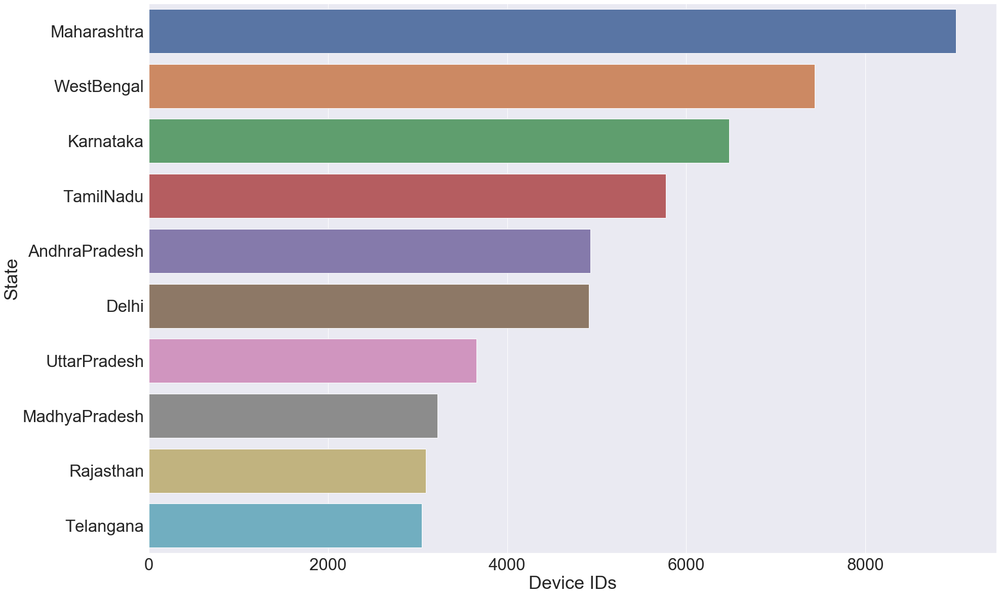

In [ ]:
from matplotlib import pyplot

import matplotlib.font_manager as font_manager

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'16', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'14'}

# Set the font properties (for use in legend)   
font_path = 'C:\Windows\Fonts\Arial.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=14)
dimen=(30,20)
fig= plt.figure(figsize=(10,6))
sns.set(font_scale=3)
fig, ax = pyplot.subplots(figsize=dimen)
ax = sns.barplot(x='device_id', y='state',data=state_device.head(10))
ax.set(xlabel='Device IDs', ylabel='State')
plt.show()


__We can see we have top three states in terms of Device count are Maharastra, West Bengal and Karnataka__

In [ ]:
#Distribution of users(device_ids) across states
fig= plt.figure(figsize=(10,7))

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'16', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'14'}
plt.title('Distribution of usage across states')
plt.xlabel('States')
plt.ylabel('users across states')
plt.xticks(**axis_font)
plt.yticks(**axis_font)
plt.xlabel('States', **axis_font)
plt.ylabel("users across states", **axis_font)
plt.title("Distribution of usage across States(Top 10 Brands)", **title_font)
#plt.legend(loc='center', prop=font_prop, numpoints=1)

state = df_events['state'].value_counts().head(10).plot.bar()
plt.show()

__We can see we have top three states in terms of Device usage are Delhi, Maharastra and TamilNadu__



### <a id=section42></a> Q2. What is the spread of users across Phone Brands(Consider only 10 Most used Phone Brands)?

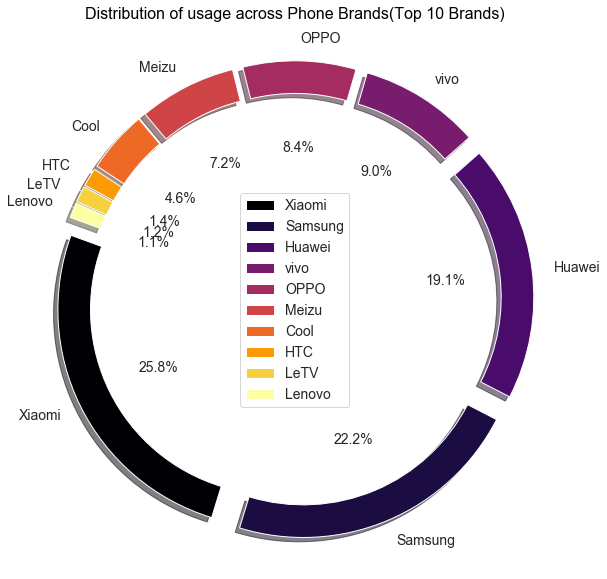

In [ ]:
fig= plt.figure(figsize=(10,7))

plt.title('Distribution of usage across Phone Brands')
plt.xlabel('Phone Brand')
plt.ylabel('users across Phone Brands')
#print(df_merge_all['phone_brand'].value_counts().head(10))

df_plot = df_merge_mh.drop_duplicates(subset = ["device_id"]).sort_values(by='device_id')
#df_plot.sort_values(by='algebra')
df_plot.describe()
df_plot.head()

mycriteria = ["Xiaomi","Samsung", "Huawei", "vivo", "OPPO", "Meizu", "Cool", "HTC","Lenovo","LeTV"]
new = df_plot["phone_brand"].isin(mycriteria) 
df_plot1 = df_plot[new]

space = np.ones(10)/10
df_plot1['phone_brand'].value_counts().plot(kind='pie',  explode=space, fontsize=14, autopct='%3.1f%%', wedgeprops=dict(width=0.15), 
                                       shadow=True, startangle=160, figsize=(10,10), cmap='inferno', legend=True)

plt.xlabel("", **axis_font)
plt.ylabel("", **axis_font)
plt.title("Distribution of usage across Phone Brands(Top 10 Brands)", **title_font)
plt.legend(loc='center', prop=font_prop, numpoints=1)
#plt.text(0, 0, "Misc text", **title_font)
    
#import plotly.express as px

#fig = px.pie(df_plot1, values='device_id', names='phone_brand')
#fig.update_traces(textposition='inside', textfont_size=14)
#fig.show()

#plt.ylabel('Category')
#plt.title('Proportion of each Brand in terms of users value')
#plt.legend(labels=('Total_Fat', 'Saturated_Fat', 'Trans_Fat'))

__There are 77 distant phone brands. Maximum number of users use Xiaomi, closely followed by Samsung & Huawei. These 3 phone brands totally account for ~60% users. The 7 phone brands (Xiaomi, Samsung, Huawei, vivo, OPPO, Meizu, Cool) totally account for ~90% users. These top 10 brands have 98.5% users in Maharashtra. All other phone brands contribute less than 1.5% each.__

### <a id=section43></a> Q3.  What is the spread of users across Gender?

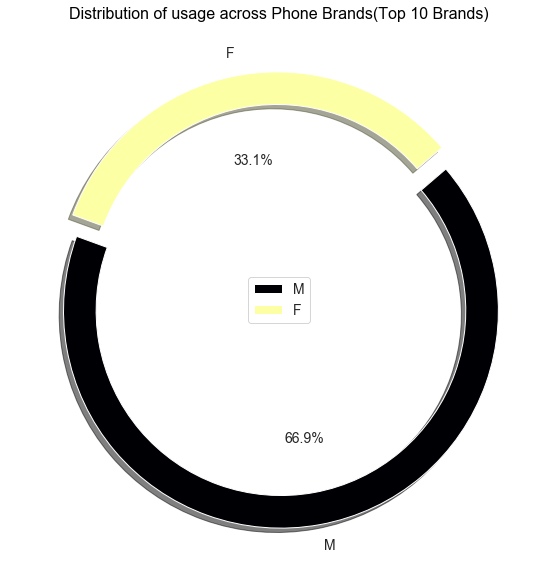

In [ ]:
#Distribution of users across Gender
import matplotlib.pyplot as plt
import seaborn as sns
#ax = sns.countplot(x='gender', data=df_merge_mh)
#plt.title('Distribution of users across gender')


fig= plt.figure(figsize=(10,7))


plt.title('Distribution of usage across Phone Brands')
plt.xlabel('Phone Brand')
plt.ylabel('users across Phone Brands')
#print(df_merge_all['phone_brand'].value_counts().head(10))

space = np.ones(2)/20
df_merge_mh['gender'].value_counts().plot(kind='pie',  explode=space, fontsize=14, autopct='%3.1f%%', wedgeprops=dict(width=0.15), 
                                       shadow=True, startangle=160, figsize=(10,10), cmap='inferno', legend=True
                                         )

plt.xlabel("", **axis_font)
plt.ylabel("", **axis_font)
plt.title("Distribution of usage across Phone Brands(Top 10 Brands)", **title_font)
plt.legend(loc='center', prop=font_prop, numpoints=1)

plt.show()





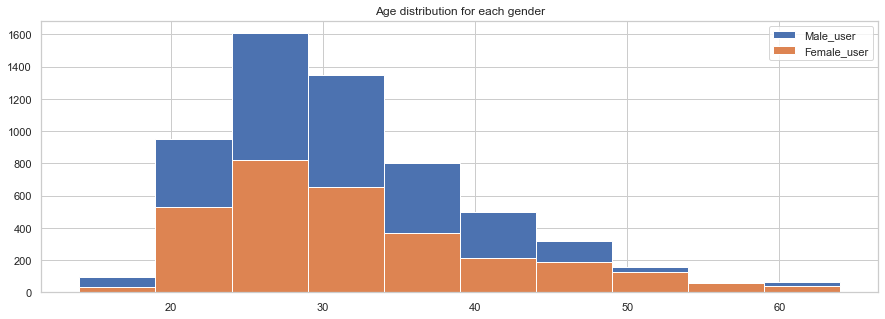

In [ ]:
# Age distribution for each gender
plt.figure(figsize=(15,5))
sns.set(style="whitegrid")
df_plot = df_merge_mh.drop_duplicates(subset = ["device_id"]).sort_values(by='device_id')

plt.title("Age distribution for each gender")
Male_user = df_plot[df_plot['gender'] == 'M'].copy()
Male_user = Male_user['age']
Female_user = df_plot[df_plot['gender'] == 'F'].copy()
Female_user = Female_user['age']

plt.hist(Male_user, label='Male_user')
plt.hist(Female_user, label='Female_user')
plt.legend()

__We have 66.90% Male and 33.10% Female users. Age of maximum users (Male & Female) are around 20 to 40. Almost 50% of the users are of age between 22 to 32.__

### <a id=section44></a> Q4. What is the spread of users across Age Segments?

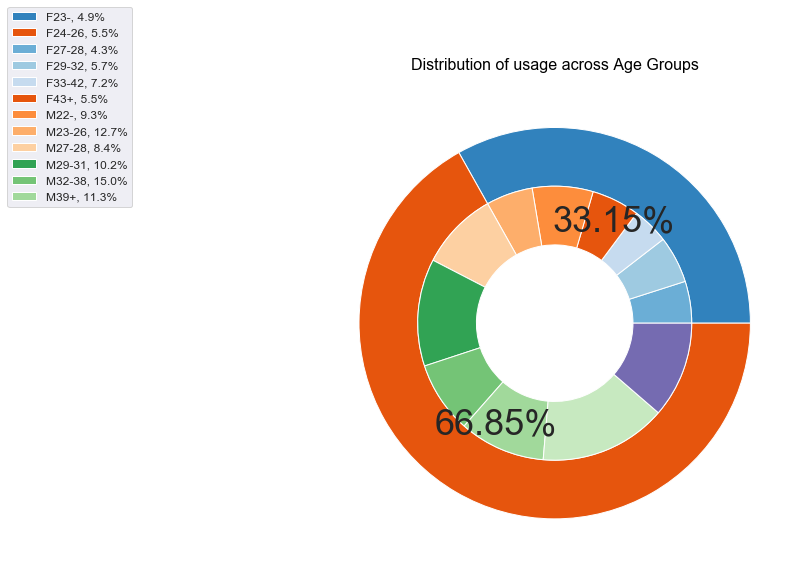

In [ ]:
import numpy as np

###pie chart for group

df_merge_mh['group'].value_counts()
group_count=df_merge_mh['group'].value_counts().reset_index().sort_values(by='index')
group_count.columns=['group','Count']

g_count=df_merge_mh['gender'].value_counts().reset_index().sort_values(by='index')
g_count.columns=['gender','Count']


# Create a trace
tag = (np.array(group_count.group))
sizes = (np.array((group_count['Count'] / group_count['Count'].sum())))
g_sizes = (np.array((g_count['Count'] / g_count['Count'].sum())))
g_tag = (np.array(g_count.gender))

grp_labels = zip(tag, sizes)
g_labels = zip(g_tag, g_sizes)


fig, ax = plt.subplots(figsize=(15,9))

size = 0.3
cmap = plt.get_cmap("tab20c")
outer_colors = cmap(np.arange(3)*4)
inner_colors = cmap(np.array([1, 2, 3,4,5, 6,7,8, 9, 10,11,12]))


ax.pie(g_sizes, radius=1, colors=outer_colors,autopct='%.2f%%',#labels=g_tag,
       wedgeprops=dict(width=size, edgecolor='w'))

ax.pie(sizes, radius=1-size, colors=inner_colors,#autopct='%3.1f%%',#labels=tag,
       wedgeprops=dict(width=size, edgecolor='w'))


ax.set(aspect="equal", title='Pie plot with `ax.pie`')
plt.xlabel("", **axis_font)
plt.ylabel("", **axis_font)
plt.title("Distribution of usage across Age Groups", **title_font)
#plt.legend(loc='right', prop=font_prop, numpoints=1)

plt.legend(
    loc='upper left',
    prop={'size': 12},
    labels=['%s, %1.1f%%' % (
        l, (float(s)) * 100) for l, s in grp_labels],
    bbox_to_anchor=(0.0, 1),
    bbox_transform=fig.transFigure
)


#plt.legend(loc='center', prop=font_prop, numpoints=1)
plt.show()



__There are 12 distinct age groups defined in the dataset (seperating male & female). All male age group user counts are higher than the female age group user counts. Even though maximum users are between 22 to 32, age group M32-38, M39+ dominates in the graph due to bigger age band as compared to M23-26, M27-28, M29-31.__

### <a id=section45></a> Q5. What is the Distribution of Phone Brands(Consider only 10 Most used Phone Brands) for each Age Segment, State, Gender?

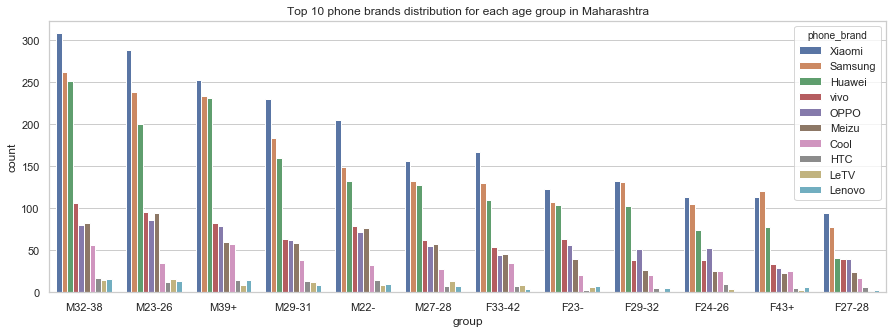

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("group", hue="phone_brand", hue_order=df_plot.phone_brand.value_counts().iloc[:10].index, order=df_plot.group.value_counts().iloc[:].index, data=df_plot)
plt.title("Top 10 phone brands distribution for each age group in Maharashtra")
plt.show()

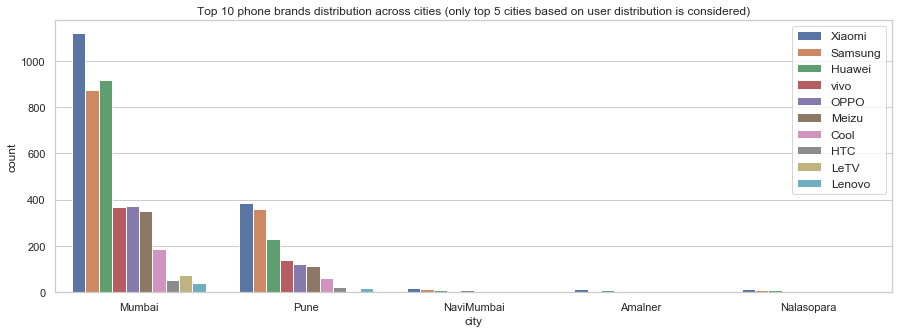

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("city", hue="phone_brand", hue_order=df_plot.phone_brand.value_counts().iloc[:10].index, order=df_plot.city.value_counts().iloc[:5].index, data=df_plot)
plt.title("Top 10 phone brands distribution across cities (only top 5 cities based on user distribution is considered)")
plt.legend(
    loc='upper right',
    prop={'size': 12}
)
plt.show()

Text(0.5, 1.0, 'Top 10 phone brands distribution for each gender')

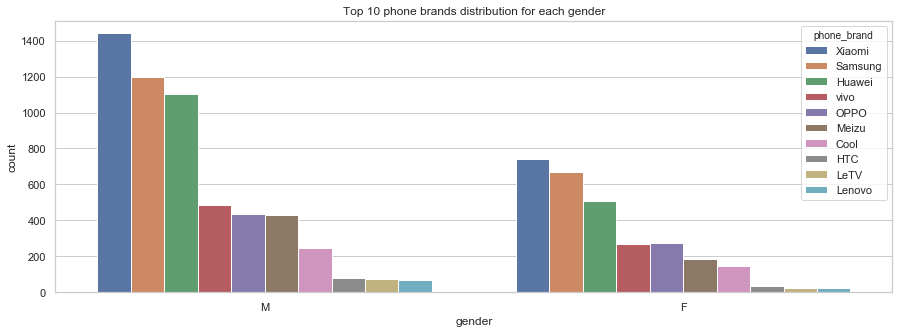

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("gender", hue="phone_brand", hue_order=df_plot.phone_brand.value_counts().iloc[:10].index, data=df_plot)
plt.title("Top 10 phone brands distribution for each gender")

### <a id=section46></a> Q6. What is the Distribution of Gender for each State, Age Segment and Phone Brand(Consider only 10 Most used Phone Brands)?

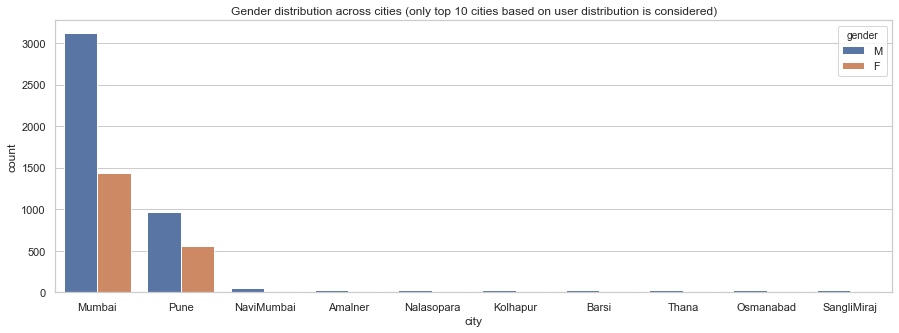

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("city", hue="gender", order=df_plot.city.value_counts().iloc[:10].index, data=df_plot)
plt.title("Gender distribution across cities (only top 10 cities based on user distribution is considered)")
plt.show()

__Plotting for top 10 cities may not be required as the user counts in cities other than Mumbai & Pune are negligible. Male users are higher in every city. (Almost double than the female users)__

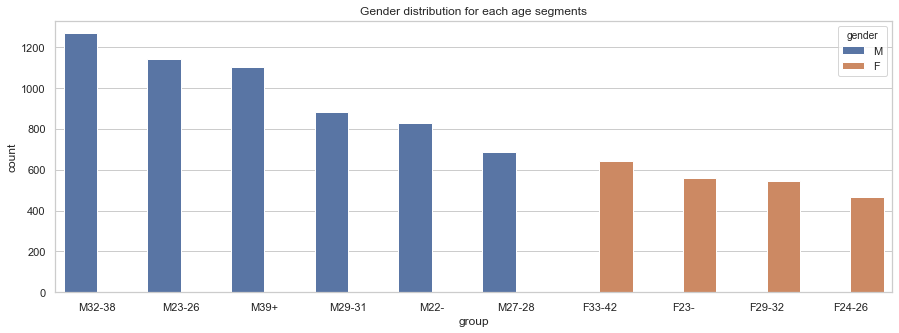

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("group", hue="gender", order=df_plot.group.value_counts().iloc[:10].index, data=df_plot)
plt.title("Gender distribution for each age segments")
plt.show()

Text(0.5, 1.0, 'Gender distribution for top 10 phone brands')

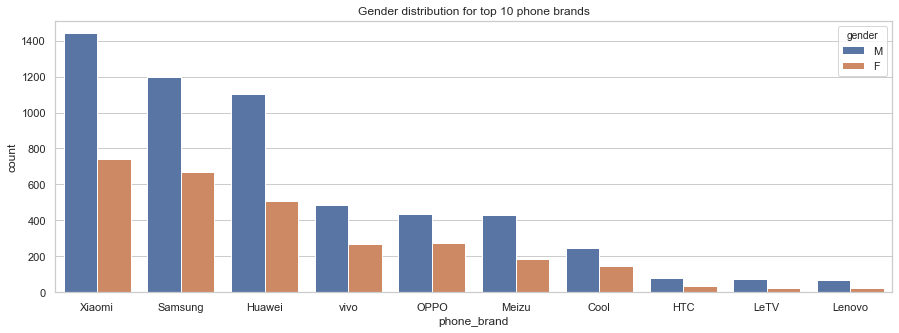

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("phone_brand", hue="gender", order=df_plot.phone_brand.value_counts().iloc[:10].index, data=df_plot)
plt.title("Gender distribution for top 10 phone brands")

__Male users are the dominant users across the top 10 phone brands. It is also observed that top 10 phone brands is same across the gender. Both male & female users prefer Xiaomi as their top brand.__

### <a id=section47></a> Q7. Distribution of Age Segments for each State, Gender and Phone Brand(Consider only 10 Most used Phone Brands)

Text(0.5, 1.0, 'Age group distribution across cities (only top 5 cities based on user distribution is considered)')

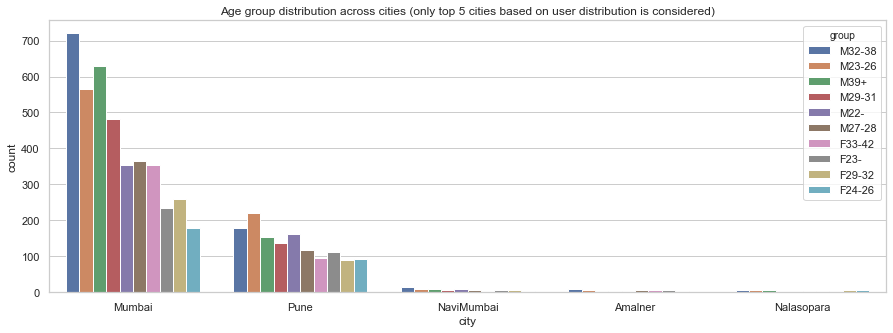

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("city", hue="group", hue_order=df_plot.group.value_counts().iloc[:10].index, order=df_plot.city.value_counts().iloc[:5].index, data=df_plot)
plt.title("Age group distribution across cities (only top 5 cities based on user distribution is considered)")

Text(0.5, 1.0, 'Age group distribution for top 10 phone brands')

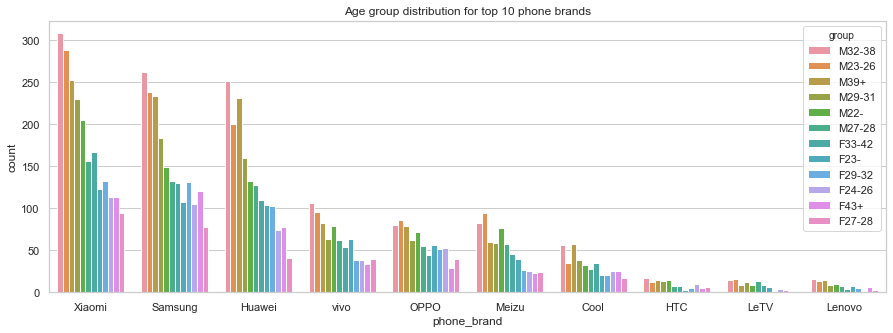

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("phone_brand", hue="group", order=df_plot.phone_brand.value_counts().iloc[:10].index, hue_order=df_plot.group.value_counts().iloc[:].index, data=df_plot)
plt.title("Age group distribution for top 10 phone brands")

__M32-38 users are almost dominant users across all top 10 phone brands.__

Text(0.5, 1.0, 'Age group distribution for each gender')

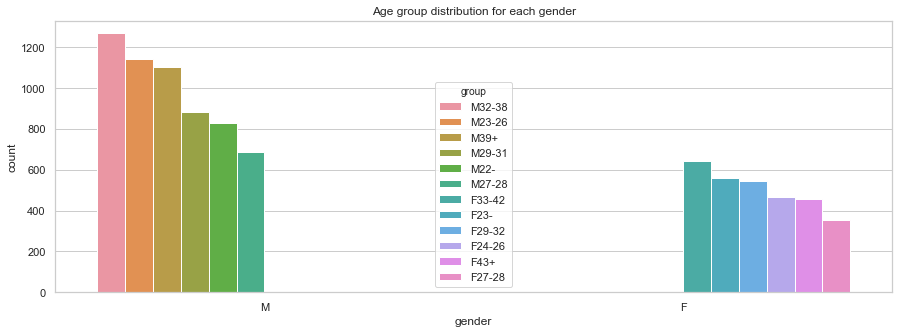

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("gender", hue="group", hue_order=df_plot.group.value_counts().iloc[:].index, data=df_plot)
plt.title("Age group distribution for each gender")

### <a id=section49></a> Q8. Distribution of Age for each State, Gender and Phone Brand(Consider only 10 Most used Phone Brands?

Text(0.5, 1.0, 'Age Box plot across cities')

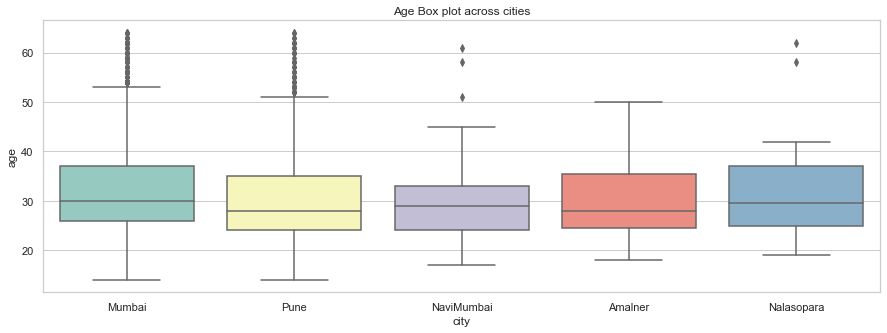

In [ ]:
# Box plot for age
plt.figure(figsize=(15,5))
sns.set(style="whitegrid")
sns.boxplot(y="age", x="city", order=df_plot.city.value_counts().iloc[:5].index, data=df_plot, palette="Set3")
plt.title("Age Box plot across cities")
# sns.despine()

__Median age across top 5 cities are almost same. Age variance between Mumbai & Pune are almost same.__

Text(0.5, 1.0, 'Age Box plot for top 10 phone brands')

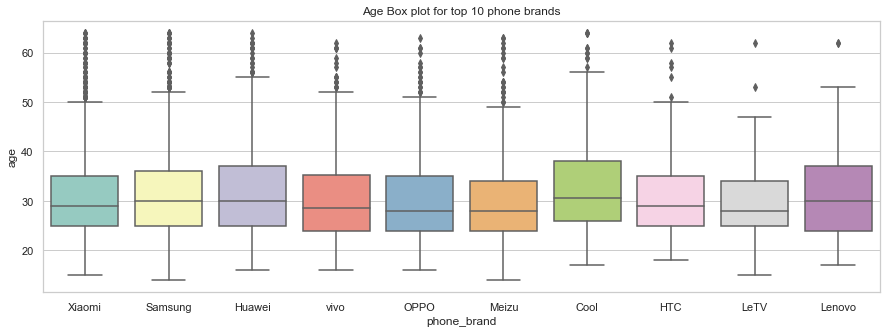

In [ ]:
# Box plot for age
plt.figure(figsize=(15,5))
sns.set(style="whitegrid")
sns.boxplot(y="age", x="phone_brand", order=df_plot.phone_brand.value_counts().iloc[:10].index, data=df_plot, palette="Set3")
plt.title("Age Box plot for top 10 phone brands")
# sns.despine()

__Median age of users across top 10 phone brands are almost same.__

Text(0.5, 1.0, 'Age Box plot for each gender')

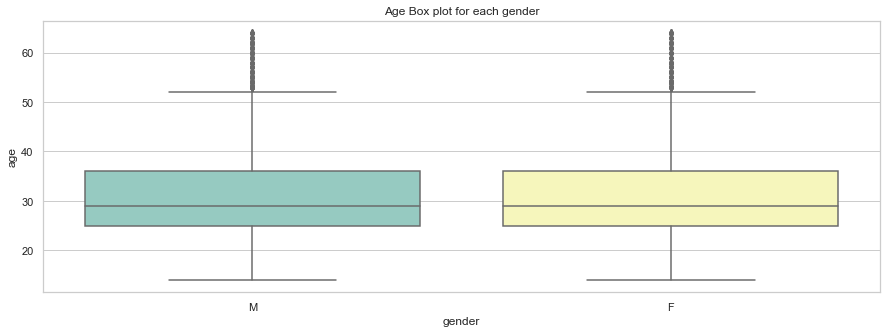

In [ ]:
# Box plot for age
plt.figure(figsize=(15,5))
sns.set(style="whitegrid")
sns.boxplot(y="age", x="gender", data=df_plot, palette="Set3")
plt.title("Age Box plot for each gender")
# sns.despine()

__Median age of users between male & female are almost same. Age variance betweenMale & Female are almost same. Lower outlier (age = 6) is a male user.__

### <a id=section49></a> Q9. Hourly distribution of Phone Calls?

In [ ]:
df_mh_hour=df_merge_mh.groupby(['hour'])['event_id'].count().reset_index()
print(df_mh_hour)

    hour  event_id
0      0     22478
1      1     13498
2      2     10351
3      3     10718
4      4     10760
5      5     17148
6      6     31107
7      7     37512
8      8     33753
9      9     32904
10    10     35113
11    11     32336
12    12     31627
13    13     29979
14    14     29670
15    15     29461
16    16     29625
17    17     30122
18    18     32181
19    19     34532
20    20     39394
21    21     39140
22    22     35690
23    23     28069


In [ ]:
plot_data = [
    go.Bar(
        x=df_mh_hour['hour'],
        y=df_mh_hour['event_id'],
    )
]

plot_layout = go.Layout(
        xaxis={"type": "category"},
        title='Events in each hour'
    )

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

__We can see that maximum calls happen from 7 AM till 10 PM in the night__

Text(0.5, 1.0, 'Hourly call distribution for each gender')

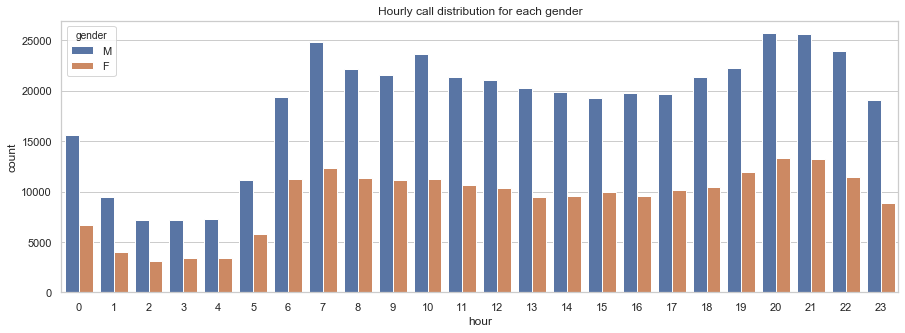

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("hour", hue="gender", hue_order=df_merge_mh.gender.value_counts().iloc[:].index, data=df_merge_mh)
plt.title("Hourly call distribution for each gender")

Text(0.5, 1.0, 'Hourly call distribution for top 2 cities')

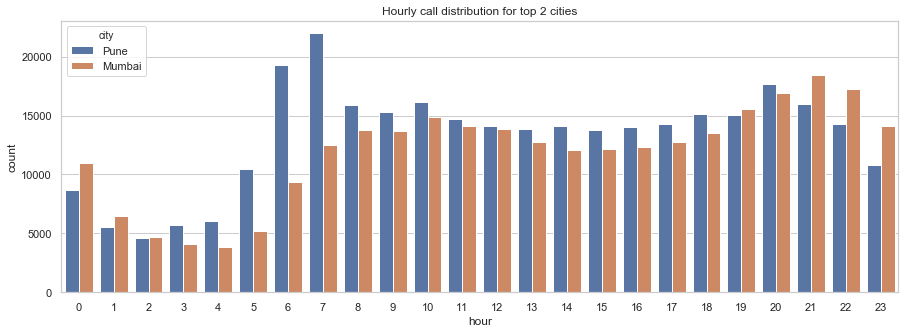

In [ ]:
plt.figure(figsize=(15,5))
sns.countplot("hour", hue="city", hue_order=df_merge_mh.city.value_counts().iloc[:2].index, data=df_merge_mh)
plt.title("Hourly call distribution for top 2 cities")

__Hourly call distribution is almost similar between Pune & Mumbai (Top 2 cities) except between 6-7AM Number of events between 6-7AM is almost doubled than Mumbai. It looks like Pune users are early morning callers.__

### <a id=section50></a> Q10.  Day wise distribution of Phone Calls
__Lets check which month data do we have__

In [ ]:
#check the database contains the data of which month 
df_merge_mh['month'].unique()

__We have data from April and May__

In [ ]:
df_april = df_merge_mh[df_merge_mh['month'] == 4]
df_april


In [ ]:
df_april_event = df_april.groupby(['date'])['event_id'].nunique().reset_index()
df_april_event

__For Month of April we have all the data from 30th April only__


__Let's check how events dada spreads in month of May__

In [ ]:
df_may = df_merge_mh[df_merge_mh['month'] == 5]
df_may.head()
df_may.shape

(676978, 18)

In [ ]:
df_may_event = df_may.groupby(['date'])['event_id'].nunique().reset_index()
df_may_event

plot_data = [
    go.Bar(
        x=df_may_event['date'],
        y=df_may_event['event_id'],
    )
]

plot_layout = go.Layout(
        xaxis={"type": "category"},
        title='Events in May Month'
    )

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [ ]:
!pip install plotly

### <a id=section51></a> Q10.  Month wise distribution of Phone Calls

In [ ]:
plot_data = [
    go.Bar(
        x=df_may_event['date'],
        y=df_may_event['event_id'],
    )
]

plot_layout = go.Layout(
        xaxis={"type": "category"},
        title='Events in May Month'
    )

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [ ]:
df_merge_mh['city'].nunique()

87

In [ ]:
df_mh_city = df_merge_mh.groupby(['city'])['event_id'].nunique().sort_values(ascending=False).reset_index().head(10)
df_mh_city

,city,event_id
0,Pune,317276
1,Mumbai,285246
2,NaviMumbai,1760
3,SangliMiraj,1737
4,Wardha,1674
5,Nagpur,1589
6,Dhule,1572
7,Warud,1536
8,MiraBhayandar,1443
9,Nanded,1433


In [ ]:
#Install Folium
! pip install folium

### Visualization using Folium for spread of users

In [ ]:
import folium
#from folium.plugins import BeautifyIcon
from IPython.display import display
m= folium.Map(location=[18.516726, 73.856255], 
                    tiles='cartodbpositron', 
                    zoom_start=5,
                    control_scale=True)
feature_group = folium.FeatureGroup("Locations")
for ind in df_merge_mh.index: 
    longitude = df_merge_mh['longitude'][ind]
    latitude = df_merge_mh['latitude'][ind]
    popupStr =  df_merge_mh['device_id'][ind]
  
     
    feature_group.add_child(folium.CircleMarker(location=[latitude, longitude], 
                           fill_color='33F6FF',color="#ee1414",radius=1))
m.add_child(feature_group)
m

In [ ]:
# Plotting latitude & longitude values in map using Folium to crosscheck whether chosen latitude & longitude values are outside maharashtra
map_vis1 = folium.Map(location=[lat_mode, long_mode], zoom_start=5, tiles='Stamen Terrain')

for lat, lon in zip(df_merge_mh['latitude'], df_merge_mh['longitude']):
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup = ('Lat: ' + str(lat) + '<br>'
                 'Long: ' + str(lon) + '<br>'
        ),
        color='blue',
        fill=True,
        fill_opacity=0.7
        ).add_to(map_vis1)
map_vis1

### Conclusion:

 As part of this project we have studied the InsaidTelecom user and device usge data for Maharashta. After doing the data analysis here are following observations:
 -  In terms of mobile usage Delhi is the topmost state however in terms of mobile users Maharashtra is top
 -  We have observed that age group between 20-40 are most users
 -  We have more male users approax 66% as compared to 34% female users
 -  In Maharashtra State more than 90% users belong to Mumbai and Pune. There are very few users in other cities, there are 87 cities in Maharashtra. __InsaidTelecom__ can take other cities to increase their userbase
 -  Xiomi, Samsung, Huawei, Vivo are the most favoured brands of phones